In [0]:
from pyspark.sql import SparkSession

spark = SparkSession.builder.appName("s8a-dataframes-api").getOrCreate()
# Lectura de CSV con el ; como separador de columnas y con encabezado
df = spark.read.option("sep",";").option("header", "true").option("inferSchema", "true").csv("dbfs:/FileStore/shared_uploads/notebook_1/pdi_sales_small.csv")
df.printSchema()

root
 |-- ProductID: integer (nullable = true)
 |-- Date: date (nullable = true)
 |-- Zip: string (nullable = true)
 |-- Units: integer (nullable = true)
 |-- Revenue: double (nullable = true)
 |-- Country: string (nullable = true)



# Agregaciones

Una vez tenemos un DataFrame, podemos realizar analítica de datos sobre el dataset entero, o sobre una o más columnas y aplicar una función de agregación que permita sumar, contar o calcular la media de cualquier grupo, entre otras opciones. Para ello, PySpark ofrece un amplio [conjunto de funciones](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql.html#functions). En nuestro caso, vamos a realizar algunos ejemplos para practicar con las funciones más empleadas.

## Contando

**[count](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.count.html)** : Devuelve la cantidad de elementos no nulos.

In [0]:
from pyspark.sql.functions import count
df.select(count(df.Country)).show()

+-----------------------+
|count(DISTINCT Country)|
+-----------------------+
|                      5|
+-----------------------+



**[count_distinct/countDistinct](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.count_distinct.html):** Devuelve la cantidad de elementos no nulos diferentes:  

In [0]:
from pyspark.sql.functions import count_distinct
df.select(count_distinct("Country"), count_distinct("Zip")).show()

+-----------------------+-------------------+
|count(DISTINCT Country)|count(DISTINCT Zip)|
+-----------------------+-------------------+
|                      5|               2585|
+-----------------------+-------------------+



**[approx_count_distinct / approxCountDistinct:](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.approx_count_distinct.html)** Devuelve aproximadamente la cantidad de elementos no nulos diferentes (puede recibir un segundo parámetro la máximo desviación estándar admitida). Este método es mucho más rápido que contar exactamente el número de resultado, y para datasets muy grandes, en ocasiones puede ser útil:

In [0]:
from pyspark.sql.functions import approx_count_distinct
df.select(approx_count_distinct("Country"), approx_count_distinct("Zip")).show()

+------------------------------+--------------------------+
|approx_count_distinct(Country)|approx_count_distinct(Zip)|
+------------------------------+--------------------------+
|                             5|                      2737|
+------------------------------+--------------------------+



## Calculando

**[min](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.min.html) y [max](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.max.html)**: permiten obtener el menor y el mayor valor respectivamente:

In [0]:
from pyspark.sql.functions import min, max
df.select(min("Units"), max("Units")).show()

+----------+----------+
|min(Units)|max(Units)|
+----------+----------+
|         1|        77|
+----------+----------+



[sum](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.sum.html) permite sumar todos los valores de una columna:

In [0]:
from pyspark.sql.functions import sum
df.select(sum("Units"), sum("Revenue")).show()

+----------+-------------------+
|sum(Units)|       sum(Revenue)|
+----------+-------------------+
|    125728|5.010727499998837E7|
+----------+-------------------+



**[sum_distinct / sumDistinct](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.sum_distinct.html)**: suma los valores diferentes de una columna:

In [0]:
from pyspark.sql.functions import sum_distinct
df.select(sum_distinct("Units"), sum_distinct("Revenue")).show()

+-------------------+---------------------+
|sum(DISTINCT Units)|sum(DISTINCT Revenue)|
+-------------------+---------------------+
|                308|    1189127.099999999|
+-------------------+---------------------+



**Asimetría, varianza y desviación estándar**: Si nos interesa obtener información estadística sobre los datos, también disponemos de las funciones `skewness`, `kurtosis`, `variance`, `var_pop`, `stddev` y `stddev_pop`.

> Actividad: Desarrolla ejemplos simples de como calcular con Pyspark las funciones `skewness`, `kurtosis`, `variance`, `var_pop`, `stddev` y `stddev_pop`. Explicar como se interpretan cada una de ellas.

In [0]:
df.display()

ProductID,Date,Zip,Units,Revenue,Country
725,1999-01-15,41540,1,115.5,Germany
787,2002-06-06,41540,1,314.9,Germany
788,2002-06-06,41540,1,314.9,Germany
940,1999-01-15,22587,1,687.7,Germany
396,1999-01-15,22587,1,857.1,Germany
734,2003-04-10,22587,1,330.7,Germany
769,1999-02-15,22587,1,257.2,Germany
499,1999-01-15,12555,1,846.3,Germany
2254,1999-01-15,40217,1,57.7,Germany
31,2002-05-31,40217,1,761.2,Germany


In [0]:
from pyspark.sql.functions import skewness, kurtosis, variance, var_pop, stddev, stddev_pop

#En el contexto de análisis de datos, skewness (o sesgo en español) mide el grado de asimetría de una distribución en torno a su media. Se utiliza para entender si los datos están distribuidos de manera uniforme o si tienen una inclinación hacia un lado (izquierda o derecha).
df.select(skewness(df.Revenue)).show()

#La kurtosis (o curtosis en español) es una medida estadística que describe la forma de las colas de una distribución en comparación con una distribución normal. Específicamente, evalúa la presencia de valores extremos (outliers) y cómo están distribuidos
df.select(kurtosis(df.Revenue)).show()

#La varianza es una medida de dispersión que indica cuánto varían los datos en un conjunto respecto a su media. En términos más simples, mide qué tan "extendidos" están los valores en un conjunto de datos.
df.select(variance(df.Revenue)).show()

#La función var_pop en PySpark se utiliza para calcular la varianza poblacional de una columna numérica. A diferencia de la varianza muestral (variance), la varianza poblacional considera que tienes datos de toda la población, no solo de una muestra.
df.select(var_pop(df.Revenue)).show()

#La función stddev en PySpark se utiliza para calcular la desviación estándar muestral de una columna numérica. La desviación estándar mide cuánto se desvían, en promedio, los valores de un conjunto de datos respecto a la media. Es una medida de dispersión que se encuentra en las mismas unidades que los datos originales, lo que la hace más interpretable que la varianza.
df.select(stddev(df.Revenue)).show()

#La función stddev_pop en PySpark se utiliza para calcular la desviación estándar poblacional de una columna numérica. La desviación estándar poblacional mide la dispersión de todos los valores de una población respecto a su media.
df.select(stddev_pop(df.Revenue)).show()



+------------------+
| skewness(Revenue)|
+------------------+
|17.378580618134137|
+------------------+

+-----------------+
|kurtosis(Revenue)|
+-----------------+
|1863.073715098713|
+-----------------+

+------------------+
| var_samp(Revenue)|
+------------------+
|123346.08329275507|
+------------------+

+------------------+
|  var_pop(Revenue)|
+------------------+
|123345.05745186073|
+------------------+

+--------------------+
|stddev_samp(Revenue)|
+--------------------+
|  351.20661054820005|
+--------------------+

+-------------------+
|stddev_pop(Revenue)|
+-------------------+
| 351.20515009302005|
+-------------------+



## Agrupando  

Si agrupamos varias columnas de tipo categóricas (con una cardinalidad baja), podemos realizar cálculos sobre el resto de columnas.  

Sobre un DataFrame, podemos agrupar los datos por la columna que queramos utilizando el método[ groupBy](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.DataFrame.groupBy.html), el cual nos devuelve un [GroupedData](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.GroupedData.html#pyspark.sql.GroupedData), sobre el que posteriormente realizar operaciones como `avg(cols)`, `count()`, `mean(cols)`, `min(cols)`, `max(cols)` o `sum(cols)`:

**count**: 

In [0]:
from pyspark.sql.functions import sum
df.groupBy("Country").count().show()

+-------+-----+
|Country|count|
+-------+-----+
|Germany|30059|
|France |30059|
|Canada |30060|
|Mexico |30060|
| France|    1|
+-------+-----+



**sum**

In [0]:
df.groupBy("Country").sum("Revenue").show()

+-------+--------------------+
|Country|        sum(Revenue)|
+-------+--------------------+
|Germany|  1.49821199999994E7|
|France |1.2086961900000686E7|
|Canada |1.1642614200001836E7|
|Mexico |1.1394598700001087E7|
| France|               980.2|
+-------+--------------------+



Si necesitamos realizar más de un agregación sobre el mismo grupo, mediante [agg](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.GroupedData.agg.html) podemos indicar una o más expresiones de columnas:

In [0]:
from pyspark.sql.functions import sum, count
df.groupBy("Country").agg(sum("Revenue"), count("Revenue")).show()

+-------+--------------------+--------------+
|Country|        sum(Revenue)|count(Revenue)|
+-------+--------------------+--------------+
|Germany|  1.49821199999994E7|         30059|
|France |1.2086961900000686E7|         30059|
|Canada |1.1642614200001836E7|         30060|
|Mexico |1.1394598700001087E7|         30060|
| France|               980.2|             1|
+-------+--------------------+--------------+



También podemos indicar los elementos a calcular mediante un diccionario donde las claves son los campos y los valores la función a calcular:

In [0]:
df.groupBy("Country").agg({"Zip":"count", "Revenue":"avg"}).show()

+-------+----------+------------------+
|Country|count(Zip)|      avg(Revenue)|
+-------+----------+------------------+
|Germany|     30059| 498.4237665923484|
|France |     30059| 402.1079177617581|
|Canada |     30060|387.31251497012096|
|Mexico |     30060| 379.0618330007015|
| France|         1|             980.2|
+-------+----------+------------------+



## Agrupando colecciones

En ocasiones necesitamos agrupar en una colección todos los valores para un grupo en particular. Para ello, podemos usar [collect_list](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.collect_list.html) (con repetidos) o [collect_set](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.collect_set.html) (sin repeticiones):  

Por ejemplo, para cada país, vamos a recuperar un listado con los códigos postales de aquellos pedidos que hayan superado las 5 unidades:

In [0]:
from pyspark.sql.functions import collect_list, collect_set
df.where("Units > 5").groupBy("Country").agg(collect_list("Zip"), collect_set("Zip")).show()

+-------+--------------------+--------------------+
|Country|   collect_list(Zip)|    collect_set(Zip)|
+-------+--------------------+--------------------+
|Germany|[22397          ,...|[22111          ,...|
|France |[75213 CEDEX 16 ,...|[75391 CEDEX 08 ,...|
|Mexico |[7100           ,...|[10300          ,...|
|Canada |[T2X            ,...|[T6V            ,...|
+-------+--------------------+--------------------+



## Tablas pivote  
Las tablas pivote permiten obtener un resumen de los datos a partir de columnas categóricas sobre la que realizar cálculos, tal como se hace en las hojas de cálculo con las tablas dinámicas.  

Por ejemplo, vamos a obtener la cantidad recaudada por las ventas de cada año por cada país:

In [0]:
from pyspark.sql.functions import year

df.groupBy(year("Date").alias("Year")).pivot("Country").sum("Revenue").show()


+----+------------------+------+------------------+-----------------+------------------+
|Year|           Canada |France|           France |          Germany|           Mexico |
+----+------------------+------+------------------+-----------------+------------------+
|2003| 2360085.999999949|  null|1105230.9000000039|1407119.999999999|1049457.4999999995|
|2004| 1539140.499999946|  null|              null|             null|              null|
|2001| 2193437.799999908|  null|              null|             null|233419.20000000004|
|2000|1806678.3999999042|  null|1108846.8999999764|4510606.799999929| 4240448.399999948|
|1999|1382756.6999999755|  null| 7594921.200000447|5928459.100000297|3419368.2000001906|
|2002|2360514.7999998718| 980.2| 2277962.899999955|3135934.099999969| 2451905.399999923|
+----+------------------+------+------------------+-----------------+------------------+



También podemos hacer más de un cálculo sobre la tabla pivote:  


In [0]:
df.groupBy(year("Date")).pivot("Country").agg(sum("Revenue").alias("total"), sum("Units").alias("cantidad")).display()

year(Date),Canada _total,Canada _cantidad,France_total,France_cantidad,France _total,France _cantidad,Germany_total,Germany_cantidad,Mexico _total,Mexico _cantidad
2003,2360085.999999949,6375,null,null,1105230.9000000039,2794,1407119.999999999,3099,1049457.4999999995,2510
2004,1539140.499999946,3636,null,null,null,null,null,null,null,null
2001,2193437.799999908,5976,null,null,null,null,null,null,233419.20000000004,583
2000,1806678.3999999042,5049,null,null,1108846.8999999764,2456,4510606.799999929,9738,4240448.399999948,11935
1999,1382756.6999999755,3964,null,null,7594921.200000447,20432,5928459.100000297,12266,3419368.2000001906,9895
2002,2360514.7999998718,6148,980.2,1,2277962.899999955,6056,3135934.099999969,6643,2451905.399999923,6172


## Joins

Hasta ahora todo la analítica la hemos realizado sobre un único DataFrame. Aunque si seguimos un proceso ELT es probable que tengamos todos los datos en un único lugar, en ocasiones necesitamos cruzar la información de dos datasets.

Si nos basamos en el planteamiento de una base de datos relacional, para unir dos DataFrames necesitamos unir la clave ajena de uno con la clave primaria del otro.

Para estos ejemplos, vamos a cambiar de datasets y utilizar datos de vuelos de avión que han tenido algún tipo de retraso ([departure_delays.csv](https://tajamar365.sharepoint.com/:x:/s/3405-MasterIA2024-2025/EVXFsnm7tWdIv7hohU6UsRgBIdV_ghMxvtUxSyduUcxYow?e=n85sNv)) y otro con los códigos de los aeropuertos ([airport-codes-na.tsv](https://tajamar365.sharepoint.com/:u:/s/3405-MasterIA2024-2025/EePe905sgTZOnSMvFE9DpV4BLHICLNcb9VTIYEU7svCOcw?e=AxFwQE)).

**Vuelos con retraso**  
Fichero CSV con la coma como separador de campos.   
```<csv> 
date,delay,distance,origin,destination
01011245,6,602,ABE,ATL
01020600,-8,369,ABE,DTW
01021245,-2,602,ABE,ATL
01020605,-4,602,ABE,ATL
```

**Códigos de aeropuertos**  

Fichero TSV con el tabulador como separador campos, donde el campo `IATA` es la clave de cada aeropuerto.  
```<tsv>
City State Country IATA
Abbotsford BC Canada YXX
Aberdeen SD USA ABR
Abilene TX USA ABI
Akron OH USA CAK
Alamosa CO USA ALS
Albany GA USA ABY
```

Así pues, lo primero que vamos a hacer es cargar ambos DataFrames:

In [0]:
from pyspark.sql import SparkSession

spark = SparkSession.builder.appName("s8a-dataframes-joins").getOrCreate()
df_aeropuertos = spark.read.format("csv").option("delimiter", "\t").option("header", "true").load("dbfs:/FileStore/Notebook_3/airport_codes_na-1.tsv")
df_vuelos = spark.read.format("csv").option("header", "true").load("dbfs:/FileStore/Notebook_3/departure_delays_in_-1.csv")


### Mediante SQL  
Si queremos hacer un join mediante SQL, sólo tenemos que emplear la misma sintaxis que con cualquier sistema relacional, de manera que primero crearemos las vistas temporales:

In [0]:
df_vuelos.createOrReplaceTempView("vuelos")
df_aeropuertos.createOrReplaceTempView("aeropuertos")
df_vuelos.show()
df_aeropuertos.show()

+--------+-----+--------+------+-----------+
|    date|delay|distance|origin|destination|
+--------+-----+--------+------+-----------+
|01011245|    6|     602|   ABE|        ATL|
|01020600|   -8|     369|   ABE|        DTW|
|01021245|   -2|     602|   ABE|        ATL|
|01020605|   -4|     602|   ABE|        ATL|
|01031245|   -4|     602|   ABE|        ATL|
|01030605|    0|     602|   ABE|        ATL|
|01041243|   10|     602|   ABE|        ATL|
|01040605|   28|     602|   ABE|        ATL|
|01051245|   88|     602|   ABE|        ATL|
|01050605|    9|     602|   ABE|        ATL|
|01061215|   -6|     602|   ABE|        ATL|
|01061725|   69|     602|   ABE|        ATL|
|01061230|    0|     369|   ABE|        DTW|
|01060625|   -3|     602|   ABE|        ATL|
|01070600|    0|     369|   ABE|        DTW|
|01071725|    0|     602|   ABE|        ATL|
|01071230|    0|     369|   ABE|        DTW|
|01070625|    0|     602|   ABE|        ATL|
|01071219|    0|     569|   ABE|        ORD|
|01080600|

Y a continuación realizamos la consulta:

In [0]:
df_join = spark.sql("""
                    select v.origin, a.city 
                    from vuelos v 
                    join aeropuertos a on v.origin == a.IATA""")
df_join.show()

+------+---------+
|origin|     city|
+------+---------+
|   ABE|Allentown|
|   ABE|Allentown|
|   ABE|Allentown|
|   ABE|Allentown|
|   ABE|Allentown|
|   ABE|Allentown|
|   ABE|Allentown|
|   ABE|Allentown|
|   ABE|Allentown|
|   ABE|Allentown|
|   ABE|Allentown|
|   ABE|Allentown|
|   ABE|Allentown|
|   ABE|Allentown|
|   ABE|Allentown|
|   ABE|Allentown|
|   ABE|Allentown|
|   ABE|Allentown|
|   ABE|Allentown|
|   ABE|Allentown|
+------+---------+
only showing top 20 rows



Si quisiéramos obtener el nombre de los dos aeropuertos, necesitamos realizar dos veces el join:

In [0]:
df_join = spark.sql("""
                    select v.*, a.City as originCity, b.City as destinationCity 
                    FROM vuelos v 
                    JOIN aeropuertos a on v.origin == a.IATA 
                    JOIN aeropuertos b on v.destination = b.IATA""")
df_join.show(3)

# +-------+-----+--------+------+-----------+----------+---------------+
# |   date|delay|distance|origin|destination|originCity|destinationCity|
# +-------+-----+--------+------+-----------+----------+---------------+
# |1011245|    6|     602|   ABE|        ATL| Allentown|        Atlanta|
# |1020600|   -8|     369|   ABE|        DTW| Allentown|        Detroit|
# |1021245|   -2|     602|   ABE|        ATL| Allentown|        Atlanta|
# +-------+-----+--------+------+-----------+----------+---------------+
# only showing top 3 rows



+--------+-----+--------+------+-----------+----------+---------------+
|    date|delay|distance|origin|destination|originCity|destinationCity|
+--------+-----+--------+------+-----------+----------+---------------+
|01011245|    6|     602|   ABE|        ATL| Allentown|        Atlanta|
|01020600|   -8|     369|   ABE|        DTW| Allentown|        Detroit|
|01021245|   -2|     602|   ABE|        ATL| Allentown|        Atlanta|
+--------+-----+--------+------+-----------+----------+---------------+
only showing top 3 rows



Si existiera algún vuelo cuyos códigos de aeropuerto no tuviéramos disponible en el dataset de los códigos de aeropuertos, no nos aparecería. Por tanto, sería más conveniente realizar un left join:

In [0]:
df_left_join = spark.sql("""
                         select v.*, a.City as originCity, b.City as destinationCity 
                         from vuelos v 
                         LEFT JOIN aeropuertos a on v.origin == a.IATA 
                         LEFT JOIN aeropuertos b on v.destination = b.IATA""")
df_left_join.show(3)


+-------+-----+--------+------+-----------+----------+---------------+
|   date|delay|distance|origin|destination|originCity|destinationCity|
+-------+-----+--------+------+-----------+----------+---------------+
|1011245|    6|     602|   ABE|        ATL| Allentown|        Atlanta|
|1020600|   -8|     369|   ABE|        DTW| Allentown|        Detroit|
|1021245|   -2|     602|   ABE|        ATL| Allentown|        Atlanta|
+-------+-----+--------+------+-----------+----------+---------------+
only showing top 3 rows



In [0]:
df_left_join.count()    # 1391578

Out[115]: 1391578

> **Todo tipo de joins**  
 Además de los casos vistos, podemos realizar otros tipos de joins como `cross`, `semi`, `full`, `outer`, etc... Más información en la [documentación oficial](https://spark.apache.org/docs/latest/sql-ref-syntax-qry-select-join.html)

Un caso particular que conviene conocer es el left anti join. Este tipo de join permite obtener aquellos registros de la izquierda que no aparecen en la parte derecha, de manera que si seguimos con el ejemplo, podemos recuperar aquellos vuelos cuyos aeropuertos no tenemos en el dataset con los códigos:

In [0]:
df_left_anti_join = spark.sql("""
                              select * from vuelos v 
                              LEFT ANTI JOIN aeropuertos a ON v.origin == a.IATA
                              """)
df_left_anti_join.count()   # 14416

Out[116]: 14416

### Mediante Python  

Si no queremos utilizar SQL o ya tenemos fragmentos de código que interactúan con el DataFrame API, podemos utilizar el método `join`. Este método une dos DataFrames, indicando la expresión de unión y opcionalmente el tipo:

In [0]:
exprJoin1 = df_vuelos.origin == df_aeropuertos.IATA
df_joinp1 = df_vuelos.join(df_aeropuertos, exprJoin1, "inner")
df_joinp1.show()

+--------+-----+--------+------+-----------+---------+-----+-------+----+
|    date|delay|distance|origin|destination|     City|State|Country|IATA|
+--------+-----+--------+------+-----------+---------+-----+-------+----+
|01011245|    6|     602|   ABE|        ATL|Allentown|   PA|    USA| ABE|
|01020600|   -8|     369|   ABE|        DTW|Allentown|   PA|    USA| ABE|
|01021245|   -2|     602|   ABE|        ATL|Allentown|   PA|    USA| ABE|
|01020605|   -4|     602|   ABE|        ATL|Allentown|   PA|    USA| ABE|
|01031245|   -4|     602|   ABE|        ATL|Allentown|   PA|    USA| ABE|
|01030605|    0|     602|   ABE|        ATL|Allentown|   PA|    USA| ABE|
|01041243|   10|     602|   ABE|        ATL|Allentown|   PA|    USA| ABE|
|01040605|   28|     602|   ABE|        ATL|Allentown|   PA|    USA| ABE|
|01051245|   88|     602|   ABE|        ATL|Allentown|   PA|    USA| ABE|
|01050605|    9|     602|   ABE|        ATL|Allentown|   PA|    USA| ABE|
|01061215|   -6|     602|   ABE|      

In [0]:
df_joinp1.count()    # 1377162

Out[118]: 1377162

> **Forma corta**. Si las columnas que unen los DataFrames tienen el mismo nombre, podemos simplificar el código indicando únicamente su nombre:  
`df1.join(df2, "user_id")`  
Además, si queremos hacer un inner join, podemos no indicarlo ya que es el tipo por defecto.

En vez de pasarle `inner`, le podemos indicar el tipo de join: `left`, `right`, `cross`, `left_anti`, etc...

In [0]:
expr_join1 = df_vuelos.origin == df_aeropuertos.IATA
df_left_anti_join = df_vuelos.join(df_aeropuertos, expr_join1, "left_anti")
df_left_anti_join.count()   # 14416

Out[119]: 14416

Finalmente, como en nuestro caso teníamos dos joins, tanto para los vuelos de origen como los de destino, necesitamos volver a unir:

In [0]:
from pyspark.sql.functions import col
# le indicamos alias a los campos para eliminar ambigüedades
expr_join2 = col("a.destination") == col("b.IATA")
df_joinp2 = (df_joinp1.alias("a")).join((df_aeropuertos.alias("b")), expr_join2, "inner")
df_joinp2.count()    # 1361141

## Funciones  
Para dominar realmente Spark, hay que tener destreza en todas las funciones existentes para el tratamiento de fechas, cadenas, operaciones matemáticas, para trabajar con colecciones, etc...

Además, siempre podemos crear nuestras propias funciones de usuario para ampliar el lenguaje.

Aunque ya hemos utilizado algunas a lo largo de los apuntes, a continuación vamos a repasar las funciones más empleadas.

### Fechas  
- Si necesitamos convertir de texto a fecha: [to_date](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.to_date.html), [to_timestamp](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.to_timestamp.html), [unix_timestamp](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.unix_timestamp.html)  
- Para formatear las fechas: [date_format](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.date_format.html), [from_unixtime](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.from_unixtime.html) ([patrones de fechas](https://spark.apache.org/docs/latest/sql-ref-datetime-pattern.html))  
- Para realizar cálculos sobre fechas: `datediff`, `months_between`, `last_day`, `date_add`, `date_sub`, `next_day`.  
- Extraer un valor de una fecha:[ year](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.year.html), [month](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.month.html), [weekofyear](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.weekofyear.html), [dayofmonth](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.dayofmonth.html), [dayofyear](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.dayofyear.html), [hour](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.hour.html),[ minute](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.minute.html), [second](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.second.html).    

Más información en la [documentación oficial](https://spark.apache.org/docs/latest/sql-ref-functions-builtin.html#date-and-timestamp-functions)


In [0]:
from pyspark.sql import SparkSession
from pyspark.sql.functions import to_date

spark = SparkSession.builder.appName("s8a-dataframes-sql").getOrCreate()

df = spark.read.option("sep",";").option("header", "true").option("inferSchema", "true").csv("dbfs:/FileStore/shared_uploads/notebook_1/pdi_sales_small.csv")
# Cambiamos el tipo de dato a fecha
df = df.withColumn("Date", to_date(df.Date, "M/d/yyy"))
df.show()

+---------+----------+---------------+-----+-------+-------+
|ProductID|      Date|            Zip|Units|Revenue|Country|
+---------+----------+---------------+-----+-------+-------+
|      725|1999-01-15|41540          |    1|  115.5|Germany|
|      787|2002-06-06|41540          |    1|  314.9|Germany|
|      788|2002-06-06|41540          |    1|  314.9|Germany|
|      940|1999-01-15|22587          |    1|  687.7|Germany|
|      396|1999-01-15|22587          |    1|  857.1|Germany|
|      734|2003-04-10|22587          |    1|  330.7|Germany|
|      769|1999-02-15|22587          |    1|  257.2|Germany|
|      499|1999-01-15|12555          |    1|  846.3|Germany|
|     2254|1999-01-15|40217          |    1|   57.7|Germany|
|       31|2002-05-31|40217          |    1|  761.2|Germany|
|      475|1999-02-15|13583          |    1|  970.2|Germany|
|      510|1999-01-15|22337          |    1|  837.1|Germany|
|      499|2002-06-05|22337          |    1|  883.0|Germany|
|      289|1999-02-15|13

In [0]:
from pyspark.sql.functions import date_format, next_day, last_day, dayofmonth, dayofyear, month, year

df.select(
    "Date",
    date_format("Date", "dd-MM-yyyy").alias("Formatted_Date"),
    next_day("Date", "Sun").alias("Next_Sunday"),
    last_day("Date").alias("Last_Day_of_Month"),
    dayofmonth("Date").alias("Day_of_Month"),
    dayofyear("Date").alias("Day_of_Year"),
    month("Date").alias("Month"),
    year("Date").alias("Year")
).show(2)


+----------+--------------+-----------+-----------------+------------+-----------+-----+----+
|      Date|Formatted_Date|Next_Sunday|Last_Day_of_Month|Day_of_Month|Day_of_Year|Month|Year|
+----------+--------------+-----------+-----------------+------------+-----------+-----+----+
|1999-01-15|    15-01-1999| 1999-01-17|       1999-01-31|          15|         15|    1|1999|
|2002-06-06|    06-06-2002| 2002-06-09|       2002-06-30|           6|        157|    6|2002|
+----------+--------------+-----------+-----------------+------------+-----------+-----+----+
only showing top 2 rows



### Cadenas  
Por ejemplo, tenemos las funciones para quitar espacios ([`ltrim`](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.ltrim.html), [`rtrim`](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.rtrim.html), [`trim`](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.trim.html)) y pasar a mayúsculas/minúsculas ([`lower`](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.lower.html), [`upper`](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.upper.html)):

In [0]:
from pyspark.sql.functions import ltrim, rtrim, trim, lower, upper

df.select(
    "Zip",
    ltrim("Zip").alias("l"),  # Elimina espacios en blanco a la izquierda
    rtrim("Zip").alias("r"),  # Elimina espacios en blanco a la derecha
    lower("Zip").alias("lower(Zip)"),  # Convierte a minúsculas
    upper("Zip").alias("upper(Zip)")   # Convierte a mayúsculas
).where(
    trim(df.Country) == "Canada"  # Elimina espacios en blanco de ambos lados antes de comparar
).show(3)


+---------------+---------------+---+---------------+---------------+
|            Zip|              l|  r|     lower(Zip)|     upper(Zip)|
+---------------+---------------+---+---------------+---------------+
|H1B            |H1B            |H1B|h1b            |H1B            |
|H1B            |H1B            |H1B|h1b            |H1B            |
|H1B            |H1B            |H1B|h1b            |H1B            |
+---------------+---------------+---+---------------+---------------+
only showing top 3 rows



In [0]:
from pyspark.sql.functions import ltrim, rtrim, trim, lower, upper

df.select(
    "Zip",
    ltrim(df.Zip).alias("l"),  # Elimina espacios en blanco a la izquierda
    rtrim(df.Zip).alias("r"),  # Elimina espacios en blanco a la derecha
    lower(df.Zip).alias("lower(Zip)"),  # Convierte a minúsculas
    upper(df.Zip).alias("upper(Zip)")   # Convierte a mayúsculas
).where(
    trim(df.Country) == "Canada"  # Elimina espacios en blanco de ambos lados antes de comparar
).show(3)

+---------------+---------------+---+---------------+---------------+
|            Zip|              l|  r|     lower(Zip)|     upper(Zip)|
+---------------+---------------+---+---------------+---------------+
|H1B            |H1B            |H1B|h1b            |H1B            |
|H1B            |H1B            |H1B|h1b            |H1B            |
|H1B            |H1B            |H1B|h1b            |H1B            |
+---------------+---------------+---+---------------+---------------+
only showing top 3 rows



O funciones para poner la inicial en mayúsculas ([initcap](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.initcap.html)), darle la vuelta ([reverse](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.reverse.html)), obtener su tamaño ([length](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.length.html)) o reemplazar caracteres ([translate](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.translate.html)):

In [0]:
from pyspark.sql.functions import initcap, reverse, length, translate, trim

df.select(
    "Country",
    initcap("Country").alias("Initcap(Country)"),  # Convierte a formato título (primera letra en mayúscula)
    reverse("Country").alias("Reverse(Country)"),  # Invierte la cadena
    length("Country").alias("Length(Country)"),    # Longitud de la cadena
    translate("Country", "na", "pe").alias("Translate(Country)")  # Reemplaza 'n' con 'p' y 'a' con 'e'
).where(
    trim(df.Country) == "Canada"  # Elimina espacios en blanco antes de comparar
).show(1)


+-------+----------------+----------------+---------------+------------------+
|Country|Initcap(Country)|Reverse(Country)|Length(Country)|Translate(Country)|
+-------+----------------+----------------+---------------+------------------+
|Canada |         Canada |          adanaC|              7|           Cepede |
+-------+----------------+----------------+---------------+------------------+
only showing top 1 row



También podemos trabajar con subcadenas ([substring](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.substring.html)), encontrar ocurrencias ([locate](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.locate.html)) o partir una cadena en trozos ([split](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.split.html)):

In [0]:
from pyspark.sql.functions import split, locate, substring, trim

df.select(
    "Country",
    split("Country", "a").alias("Split(Country, 'a')"),  # Divide la cadena por el carácter 'a'
    locate("a", "Country").alias("Locate('a', Country)"),  # Encuentra la posición de la primera aparición de 'a'
    substring("Country", 3, 2).alias("Substring(Country, 3, 2)")  # Extrae dos caracteres a partir de la posición 3
).where(
    trim(df.Country) == "Canada"  # Elimina espacios en blanco antes de comparar
).show(1)


+-------+-------------------+--------------------+------------------------+
|Country|Split(Country, 'a')|Locate('a', Country)|Substring(Country, 3, 2)|
+-------+-------------------+--------------------+------------------------+
|Canada |       [C, n, d,  ]|                   2|                      na|
+-------+-------------------+--------------------+------------------------+
only showing top 1 row



Otras funciones que se suelen utilizar son [concat](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.concat.html) y [concat_ws](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.concat.html) para unir cadenas, [levenshtein](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.levenshtein.html) para calcular la distancia entre dos cadenas, [lpad](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.lpad.html) y [rpad](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.rpad.html) para completar con espacios, etc... Si necesitas trabajar con expresiones regulares puedes utilizar [regexp_extract](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.regexp_extract.html) para extraer parte de una cadena como [regexp_replace](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.regexp_replace.html) para sustituir.

### Colecciones  
Para probar las funciones que trabajan con colecciones, vamos a cambiar de dataset y trabajar con uno compartido por [Kaggle](https://www.kaggle.com/datasets/yelp-dataset/yelp-dataset) con datos de negocios de Yelp que tenemos almacenados en una versión reducida en [yelp_academic_dataset_business.json](https://tajamar365.sharepoint.com/:u:/s/3405-MasterIA2024-2025/ERoGHfFcPLhNn_YpkErPJ1oB0k9319KZG7ds-_yuklBJAg?e=ToWz1U). Los negocios tienen una propiedad denominada `categories` que contiene un array con las categorías de los mismos:

```<JSON>
{
   "business_id":"O_X3PGhk3Y5JWVi866qlJg",
   "full_address":"1501 W Bell Rd\nPhoenix, AZ 85023",
   "hours":{
      "Monday":{
         "close":"18:00",
         "open":"11:00"
      },
      "Tuesday":{
         "close":"18:00",
         "open":"11:00"
      },
        ...
   },
   "open":true,
   "categories":[
      "Active Life",
      "Arts & Entertainment",
      "Stadiums & Arenas",
      "Horse Racing"
   ],
   "city":"Phoenix",
   ...
}
```

El primer paso es cargar el documento y ver el esquema inferido por Spark:

In [0]:
from pyspark.sql import SparkSession

spark = SparkSession.builder.appName("s8a-dataframes-arrays").getOrCreate()



df = spark.read.option("inferSchema", "true").option("multiline",True).json("dbfs:/FileStore/Notebook_3/yelp_academic_dataset_business.json")

df.printSchema()

root
 |-- attributes: struct (nullable = true)
 |    |-- Accepts Credit Cards: boolean (nullable = true)
 |    |-- Alcohol: string (nullable = true)
 |    |-- Ambience: struct (nullable = true)
 |    |    |-- casual: boolean (nullable = true)
 |    |    |-- classy: boolean (nullable = true)
 |    |    |-- divey: boolean (nullable = true)
 |    |    |-- hipster: boolean (nullable = true)
 |    |    |-- intimate: boolean (nullable = true)
 |    |    |-- romantic: boolean (nullable = true)
 |    |    |-- touristy: boolean (nullable = true)
 |    |    |-- trendy: boolean (nullable = true)
 |    |    |-- upscale: boolean (nullable = true)
 |    |-- Attire: string (nullable = true)
 |    |-- Delivery: boolean (nullable = true)
 |    |-- Good For: struct (nullable = true)
 |    |    |-- breakfast: boolean (nullable = true)
 |    |    |-- brunch: boolean (nullable = true)
 |    |    |-- dessert: boolean (nullable = true)
 |    |    |-- dinner: boolean (nullable = true)
 |    |    |-- latenight

In [0]:
df.display()

attributes,business_id,categories,city,full_address,hours,latitude,longitude,name,neighborhoods,open,review_count,stars,state,type
"List(true, full_bar, List(false, false, false, false, false, false, false, false, false), casual, false, List(false, false, false, false, false, false), true, false, true, average, true, List(false, true, false, true, false), 2, false, true, true, true, free)",O_X3PGhk3Y5JWVi866qlJg,"List(Active Life, Arts & Entertainment, Stadiums & Arenas, Horse Racing)",Phoenix,"1501 W Bell Rd Phoenix, AZ 85023","List(List(18:00, 11:00), List(18:00, 11:00), List(18:00, 11:00), List(18:00, 11:00), List(18:00, 11:00), List(18:00, 11:00), List(18:00, 11:00))",33.6385727,-112.0923293,Turf Paradise Race Course,List(),true,29,4.0,AZ,business


Como se puede observar, sigue una estructura de elementos anidados.

Por ejemplo, vamos a ver mediante un ejemplo las siguientes funciones:  
- `size`: devuelve el tamaño de la colección  
- `sort_array`: ordena la colección  
- `array_contains`: comprueba si hay un elemento en la colección

In [0]:
df.select("hours").show(truncate=False)


+----------------------------------------------------------------------------------------------------------------+
|hours                                                                                                           |
+----------------------------------------------------------------------------------------------------------------+
|{{18:00, 11:00}, {18:00, 11:00}, {18:00, 11:00}, {18:00, 11:00}, {18:00, 11:00}, {18:00, 11:00}, {18:00, 11:00}}|
+----------------------------------------------------------------------------------------------------------------+



In [0]:
df = df.filter(df["hours"].isNotNull())

+--------------------+--------------------+--------------------+-------+--------------------+--------------------+----------+------------+--------------------+-------------+----+------------+-----+-----+--------+
|          attributes|         business_id|          categories|   city|        full_address|               hours|  latitude|   longitude|                name|neighborhoods|open|review_count|stars|state|    type|
+--------------------+--------------------+--------------------+-------+--------------------+--------------------+----------+------------+--------------------+-------------+----+------------+-----+-----+--------+
|{true, full_bar, ...|O_X3PGhk3Y5JWVi86...|[Active Life, Art...|Phoenix|1501 W Bell Rd\nP...|{{18:00, 11:00}, ...|33.6385727|-112.0923293|Turf Paradise Rac...|           []|true|          29|  4.0|   AZ|business|
+--------------------+--------------------+--------------------+-------+--------------------+--------------------+----------+------------+----------

In [0]:
from pyspark.sql.functions import size, sort_array, array_contains

df.select(
    "name",
    "hours.Sunday",
    size("categories").alias("totalCategories"),  # Cuenta el número de elementos en la lista 'categories'
    sort_array("categories").alias("sortedCategories"),  # Ordena los elementos de 'categories'
    array_contains("categories", "Restaurants").alias("isRestaurant")  # Verifica si 'categories' contiene "Restaurants"
).show(10, truncate=False)


+-------------------------+--------------+---------------+--------------------------------------------------------------------+------------+
|name                     |Sunday        |totalCategories|sortedCategories                                                    |isRestaurant|
+-------------------------+--------------+---------------+--------------------------------------------------------------------+------------+
|Turf Paradise Race Course|{18:00, 11:00}|4              |[Active Life, Arts & Entertainment, Horse Racing, Stadiums & Arenas]|false       |
+-------------------------+--------------+---------------+--------------------------------------------------------------------+------------+



Así pues, además del nombre, hemos obtenido el horario de los domingos utilizando la notación `.` para acceder a los campos anidados, la cantidad de categorías de cada comercio, un listado ordenado con sus categorías y finalmente si es un restaurante.

> **Tip**  
> Recuerda que en el apartado `Agrupando colecciones` vimos como podemos crear colecciones al realizar una agrupación.

Otro tipo de operación que podemos realizar es desenrollar una colección mediante la función `explode` y generar una fila nueva por cada elemento de la colección:

In [0]:
from pyspark.sql import functions as F

df.select("name", F.explode("categories")).show(10, truncate=False)
# +-------------------------+--------------------+
# |name                     |col                 |
# +-------------------------+--------------------+
# |Turf Paradise Race Course|Active Life         |
# |Turf Paradise Race Course|Arts & Entertainment|
# |Turf Paradise Race Course|Stadiums & Arenas   |
# |Turf Paradise Race Course|Horse Racing        |
# |Sam's Club Members Only  |Tires               |
# |Sam's Club Members Only  |Automotive          |
# |Sam's Club Members Only  |Fashion             |
# |Sam's Club Members Only  |Shopping            |
# |Sam's Club Members Only  |Department Stores   |
# |Forever 21               |Women's Clothing    |
# +-------------------------+--------------------+
# only showing top 10 rows

+-------------------------+--------------------+
|name                     |col                 |
+-------------------------+--------------------+
|Turf Paradise Race Course|Active Life         |
|Turf Paradise Race Course|Arts & Entertainment|
|Turf Paradise Race Course|Stadiums & Arenas   |
|Turf Paradise Race Course|Horse Racing        |
+-------------------------+--------------------+



### JSON  

Es común que se de el caso de que los datos que leemos desde un sistema externo estén en formato JSON pero que el proceso de ingesta lo haya realizado como si fuera una cadena de texto.

Supongamos que tenemos la siguiente cadena y generados un DataFrame a partir de un RDD:

In [0]:
tareas = ["""{"dia": "Lunes", "tareas": ["Corregir ejercicios", "Ir a nadar", "Comprar pan"]}"""]
# ['{"dia": "Lunes", "tareas": ["Corregir ejercicios", "Ir a nadar", "Comprar pan"]}']
tareasRDD = spark.sparkContext.parallelize(tareas)
tareasStrDF = tareasRDD.toDF("string")
# tareasStrDF es un DF con una columna con nombre value de tipo string



In [0]:
tareasStrDF.printSchema()
# root
#  |-- value: string (nullable = true)

root
 |-- value: string (nullable = true)



In [0]:
tareasStrDF.show()
# +--------------------+
# |               value|
# +--------------------+
# |{"dia": "Lunes", ...|
# +--------------------+

+--------------------+
|               value|
+--------------------+
|{"dia": "Lunes", ...|
+--------------------+



Para pasarlo a JSON, necesitamos definir un esquema con la estructura del documento JSON:  

In [0]:
from pyspark.sql.types import StructType, StructField, StringType, ArrayType

esquemaTareas = StructType([
    StructField("dia", StringType(), False),
    StructField("tareas", ArrayType(StringType(), False), False)
])

Y a continuación ya podemos transformar el formato mediante la función [`from_json`](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.from_json.html):

In [0]:
todosDF = tareasStrDF.select(F.from_json("value", esquemaTareas).alias("datos"))
todosDF.printSchema()
# root
#  |-- datos: struct (nullable = true)
#  |    |-- dia: string (nullable = true)
#  |    |-- tareas: array (nullable = true)
#  |    |    |-- element: string (containsNull = true)

root
 |-- datos: struct (nullable = true)
 |    |-- dia: string (nullable = true)
 |    |-- tareas: array (nullable = true)
 |    |    |-- element: string (containsNull = true)



Y ahora ya podemos acceder a los datos (en el siguiente ejemplo empleamos la función `getItem` para acceder a un elemento de una columna, así como la notación punto mediante una expresión y los corchetes para recuperar un determinado elemento):

In [0]:
todosDF.select(
    col("datos").getItem("dia").alias("datos.dia"),  # Extrae el campo 'dia'
    col("datos").getItem("tareas").alias("tareas"),  # Extrae el campo 'tareas' completo
    col("datos").getItem("tareas")[0].alias("tarea1")  # Accede al primer elemento de 'tareas'
).show(truncate=False)


+---------+----------------------------------------------+-------------------+
|datos.dia|tareas                                        |tarea1             |
+---------+----------------------------------------------+-------------------+
|Lunes    |[Corregir ejercicios, Ir a nadar, Comprar pan]|Corregir ejercicios|
+---------+----------------------------------------------+-------------------+



Para terminar, si necesitamos la operación inversa, y lo que queremos es crear una representación JSON de una columna, podemos utilizar la función [to_json](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.to_json.html):

In [0]:
todosDF.select(F.to_json("datos")).show(truncate=False)
# +---------------------------------------------------------------------------+
# |to_json(datos)                                                             |
# +---------------------------------------------------------------------------+
# |{"dia":"Lunes","tareas":["Corregir ejercicios","Ir a nadar","Comprar pan"]}|
# +---------------------------------------------------------------------------+
print(todosDF.collect()[0][0][1][0])

+---------------------------------------------------------------------------+
|to_json(datos)                                                             |
+---------------------------------------------------------------------------+
|{"dia":"Lunes","tareas":["Corregir ejercicios","Ir a nadar","Comprar pan"]}|
+---------------------------------------------------------------------------+

Corregir ejercicios


### UDF  
Además de las funciones que ofrece Spark, en cualquier momento podemos crear nuestras funciones de usuario (User-Defined Functions) para ampliar la expresividad de Spark. Antes de utilizarlas, las hemos de definir y registrar.

Si volvemos al dataset de ventas, teníamos la siguiente información:

In [0]:
from pyspark.sql import SparkSession

spark = SparkSession.builder.appName("s8a-dataframes-api").getOrCreate()
# Lectura de CSV con el ; como separador de columnas y con encabezado
df = spark.read.option("sep",";").option("header", "true").option("inferSchema", "true").csv("dbfs:/FileStore/shared_uploads/notebook_1/pdi_sales_small.csv")
df.printSchema()

root
 |-- ProductID: integer (nullable = true)
 |-- Date: date (nullable = true)
 |-- Zip: string (nullable = true)
 |-- Units: integer (nullable = true)
 |-- Revenue: double (nullable = true)
 |-- Country: string (nullable = true)



In [0]:
df.select("ProductID", "Revenue", "Units").sort("Units", ascending=False).show(5)
# +---------+-------+-----+
# |ProductID|Revenue|Units|
# +---------+-------+-----+
# |      495|43194.1|   77|
# |     2091| 6347.7|   41|
# |     2091| 6240.1|   41|
# |     2091| 3652.7|   24|
# |     2091| 3560.9|   23|
# +---------+-------+-----+
# only showing top 5 rows

+---------+-------+-----+
|ProductID|Revenue|Units|
+---------+-------+-----+
|      495|43194.1|   77|
|     2091| 6347.7|   41|
|     2091| 6240.1|   41|
|     2091| 3652.7|   24|
|     2091| 3560.9|   23|
+---------+-------+-----+
only showing top 5 rows



Vamos a crear una función para que, si vende más de una unidad, se le asigne a cada producto un bonus de un 1%. Para ello, primero definiremos la función mediante Python, y posteriormente, la registraremos mediante la función [udf](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.udf.html):

In [0]:
from pyspark.sql.functions import udf
from pyspark.sql.types import DoubleType

def bonus(unidades, ventas):
    if unidades == 1 :
        return 0.0
    else:
        return unidades * ventas / 100

udfBonus = udf(bonus, DoubleType())

Así pues, si realizamos una consulta, ya podemos utilizar la función recién creada como si fuera una propia de Spark:

In [0]:
df.select("ProductID", "Revenue", "Units", udfBonus(df.Units, df.Revenue)).sort("Units", ascending=False).show(5)
# +---------+-------+-----+---------------------+
# |ProductID|Revenue|Units|bonus(Units, Revenue)|
# +---------+-------+-----+---------------------+
# |      495|43194.1|   77|   33259.456999999995|
# |     2091| 6347.7|   41|             2602.557|
# |     2091| 6240.1|   41|   2558.4410000000003|
# |     2091| 3652.7|   24|    876.6479999999999|
# |     2091| 3560.9|   23|              819.007|
# +---------+-------+-----+---------------------+
# only showing top 5 rows

+---------+-------+-----+---------------------+
|ProductID|Revenue|Units|bonus(Units, Revenue)|
+---------+-------+-----+---------------------+
|      495|43194.1|   77|   33259.456999999995|
|     2091| 6347.7|   41|             2602.557|
|     2091| 6240.1|   41|   2558.4410000000003|
|     2091| 3652.7|   24|    876.6479999999999|
|     2091| 3560.9|   23|              819.007|
+---------+-------+-----+---------------------+
only showing top 5 rows



Si queremos definir la función para poder utilizarla dentro de Spark SQL y obtener el mismo resultado, hemos de registrar la función mediante *spark.udf.register*, la cual recibe el nombre que le asignaremos a la función, el nombre de la función Python a invocar, y el tipo de dato que devuelve:

In [0]:
# Registra la función UDF
spark.udf.register("udfBonus", bonus, DoubleType())

# Registra el DataFrame como una vista temporal
df.createOrReplaceTempView("ventas")

# Ejecuta la consulta SQL
spark.sql(
    """
    SELECT ProductID, Revenue, Units, 
           udfBonus(Units, Revenue) AS Bonus
    FROM ventas
    ORDER BY Units DESC
    """
).show(5)


+---------+-------+-----+------------------+
|ProductID|Revenue|Units|             Bonus|
+---------+-------+-----+------------------+
|      495|43194.1|   77|33259.456999999995|
|     2091| 6347.7|   41|          2602.557|
|     2091| 6240.1|   41|2558.4410000000003|
|     2091| 3652.7|   24| 876.6479999999999|
|     2091| 3560.9|   23|           819.007|
+---------+-------+-----+------------------+
only showing top 5 rows



> **UDF y Python**  
> En un principio, se desaconseja la creación de UDF mediante Python, ya que su uso penaliza de forma significativa el rendimiento. Los ejecutores son procesos en máquinas virtuales de Java que están escritos en Java, y por ello, ejecutan código Java o Scala de forma nativa. En cambio, para Python tiene que ejecutar un proceso separado para ejecutar la UDF, lo que implica un coste extra para serializar y volver a deserializar los datos para cada fila del dataset.  

### Cacheando  

Un DataFrame se puede persistir/cachear en memoria conforme necesitemos (también lo podemos hacer con los RDD). Su principal propósito es cuando vamos a acceder a un DataFrame una y otra vez y no necesitamos que se vuelvan a evaluar todas las operaciones (como pueden ser los algoritmos iterativos utilizados en Machine Learning).

> Si estás interesado en optimizar el uso de memoria al trabajar con DataFrames, [Brayan Buitrago](https://brabuitrago.medium.com/) tiene una serie de artículos sobre [Spark Performace: Cache() & Persist()](https://medium.com/iwannabedatadriven/spark-performace-cache-persist-i-c39e0c142fe5) muy interesantes.

Cuando persistimos un dataset, cada nodo almacena sus datos particionados en memoria y/o disco y los reutiliza en otras operaciones sobre dicho dataset.  
Para ello, se emplean los métodos [cache](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.DataFrame.cache.html) / [persist](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.DataFrame.persist.html) y [unpersist](https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.DataFrame.unpersist.html) para cachear y liberar los datos.

In [0]:
df.persist()
df.count()  # forzamos la evaluación perezosa

Out[42]: 120239

In [0]:
# Filtrar para ventas en Canadá
ventasCanada = df.filter(df["Country"] == "Canada")


In [0]:
spark.catalog.cacheTable("ventasCanada")


---------------------------------------------------------------------------
AnalysisException                         Traceback (most recent call last)
File <command-1693428716421408>:1
----> 1 spark.catalog.cacheTable("ventasCanada")

File /databricks/spark/python/pyspark/instrumentation_utils.py:48, in _wrap_function.<locals>.wrapper(*args, **kwargs)
     46 start = time.perf_counter()
     47 try:
---> 48     res = func(*args, **kwargs)
     49     logger.log_success(
     50         module_name, class_name, function_name, time.perf_counter() - start, signature
     51     )
     52     return res

File /databricks/spark/python/pyspark/sql/catalog.py:1027, in Catalog.cacheTable(self, tableName)
    992 def cacheTable(self, tableName: str) -> None:
    993     """Caches the specified table in-memory.
    994 
    995     .. versionadded:: 2.0.0
   (...)
   1025     >>> _ = spark.sql("DROP TABLE tbl1").collect()
   1026     """
-> 1027     self._jcatalog.cacheTable(tableName)

File /d

In [0]:
spark.sql("SELECT * FROM ventasCanada").show()


---------------------------------------------------------------------------
AnalysisException                         Traceback (most recent call last)
File <command-1693428716421409>:1
----> 1 spark.sql("SELECT * FROM ventasCanada").show()

File /databricks/spark/python/pyspark/instrumentation_utils.py:48, in _wrap_function.<locals>.wrapper(*args, **kwargs)
     46 start = time.perf_counter()
     47 try:
---> 48     res = func(*args, **kwargs)
     49     logger.log_success(
     50         module_name, class_name, function_name, time.perf_counter() - start, signature
     51     )
     52     return res

File /databricks/spark/python/pyspark/sql/session.py:1387, in SparkSession.sql(self, sqlQuery, args, **kwargs)
   1385 try:
   1386     litArgs = {k: _to_java_column(lit(v)) for k, v in (args or {}).items()}
-> 1387     return DataFrame(self._jsparkSession.sql(sqlQuery, litArgs), self)
   1388 finally:
   1389     if len(kwargs) > 0:

File /databricks/spark/python/lib/py4j-0.10.9.5-

Una vez persistidos los datos, si accedemos a http://localhost:4040 (si se usa Docker + Jupyter Lab) veremos en la pestaña Storage que se ha creado la tabla, su tipo de almacenamiento y particiones cacheadas. **Si estás en Databricks** has click en `Compute`, luego en `Spark UI` y despues click en `Storage`, deberias ver esto:

![](https://community.cloud.databricks.com/files/Notebook_3/1.png)

Una diferencia fundamental a la hora de persistir un DataFrame en comparación con un RDD, es que como Spark SQL conoce el esquema de los datos en el DataFrame, puede organizarlos de forma columnar y aplicar compresión sobre éstos para minimizar el espacio necesario.

## DataFrames y Pandas

En cualquier momento podemos pasar los datos de un DataFrame de PySpark a uno de Pandas para poder aprovechar su API.

Si seguimos con el dataset de Yelp, vamos a preparar una consulta de nos devuelva la cantidad de votos recibidos y puntuación media de cada ciudad:

In [0]:
from pyspark.sql import SparkSession

spark = SparkSession.builder.appName("s8a-dataframes-arrays").getOrCreate()

df = spark.read.option("inferSchema", "true").option("multiline",True).json("dbfs:/FileStore/Notebook_3/yelp_academic_dataset_business.json")

df.printSchema()

root
 |-- attributes: struct (nullable = true)
 |    |-- Accepts Credit Cards: boolean (nullable = true)
 |    |-- Alcohol: string (nullable = true)
 |    |-- Ambience: struct (nullable = true)
 |    |    |-- casual: boolean (nullable = true)
 |    |    |-- classy: boolean (nullable = true)
 |    |    |-- divey: boolean (nullable = true)
 |    |    |-- hipster: boolean (nullable = true)
 |    |    |-- intimate: boolean (nullable = true)
 |    |    |-- romantic: boolean (nullable = true)
 |    |    |-- touristy: boolean (nullable = true)
 |    |    |-- trendy: boolean (nullable = true)
 |    |    |-- upscale: boolean (nullable = true)
 |    |-- Attire: string (nullable = true)
 |    |-- Delivery: boolean (nullable = true)
 |    |-- Good For: struct (nullable = true)
 |    |    |-- breakfast: boolean (nullable = true)
 |    |    |-- brunch: boolean (nullable = true)
 |    |    |-- dessert: boolean (nullable = true)
 |    |    |-- dinner: boolean (nullable = true)
 |    |    |-- latenight

In [0]:
df.select("city").distinct().show()


+-------+
|   city|
+-------+
|Phoenix|
+-------+



In [0]:
from pyspark.sql.functions import count, avg, round
dfVotosCiudades = df.groupBy("city").agg(count("city").alias("votos"), round(avg("stars"), 3).alias("media")).orderBy("votos", ascending=False).limit(10)
dfVotosCiudades.show()
# +----------+-----+-----+
# |      city|votos|media|
# +----------+-----+-----+
# |   Phoenix| 5492|3.658|
# |Scottsdale| 2617|3.809|
# |     Tempe| 1444| 3.64|
# |      Mesa| 1348|3.644|
# |  Chandler| 1178|3.677|
# |  Glendale|  821|3.588|
# |   Gilbert|  630|3.755|
# |    Peoria|  385|3.614|
# |  Surprise|  241|3.598|
# |  Goodyear|  214|3.498|
# +----------+-----+-----+
# Esta salida se corresponde a la dataset completa de Kaggle en vez de nuestra muestra

+-------+-----+-----+
|   city|votos|media|
+-------+-----+-----+
|Phoenix|    1|  4.0|
+-------+-----+-----+



Nos traemos esos datos a Pandas mediante el método .`toPandas()`.:

In [0]:
pdVC = dfVotosCiudades.toPandas()

A partir de este momento pdVC es un DataFrame de Pandas:

In [0]:
pdVC

,city,votos,media
0,Phoenix,1,4.0


Y con el DataFrame de Pandas, ya podemos generar gráficos:

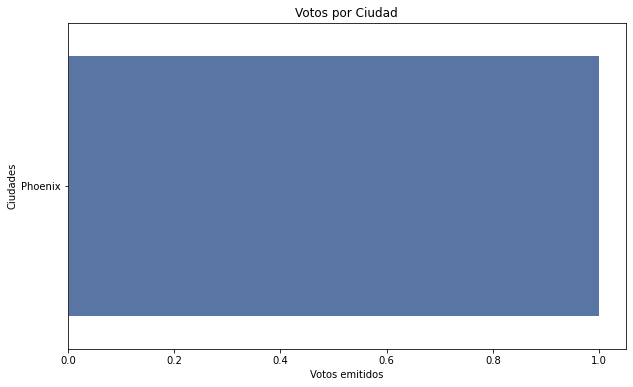

In [0]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(10,6))
plt.ticklabel_format(useOffset=False, style="plain")
sns.set_theme(style="whitegrid")
sns.barplot(x="votos", y="city", data=pdVC).set_title("Votos por Ciudad")
plt.xlabel("Votos emitidos")
plt.ylabel("Ciudades")

plt.show()

Mas exactamente la salida para la dataset completa sería:  
![](https://community.cloud.databricks.com/files/Notebook_3/5.png)

O por ejemplo, si queremos unir dos gráficos:

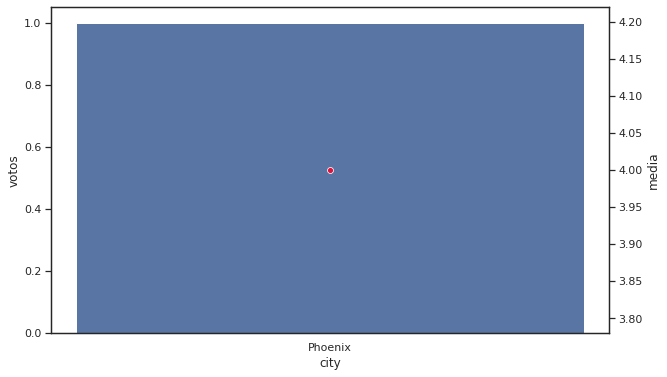

In [0]:
plt.figure(figsize=(10,6))
sns.set_theme(style="white")
ax = sns.barplot(data = pdVC, y="votos", x="city")

ax2 = ax.twinx()
sns.lineplot(data = pdVC['media'], marker='o', color='crimson', ax=ax2)
plt.show()

Mas exactamente la salida para la dataset completa sería:  
![](https://community.cloud.databricks.com/files/Notebook_3/6.png)

> **Out of Memory**  
> Mucho cuidado al utilizar Pandas, ya que al convertir el DataFrame nos vamos a traer todos los datos al driver, perdiendo la distribución de los datos y pudiendo provocar un error de falta de memoria.

Así pues, hay que evitar a toda costa utilizar Pandas para tratar los datos, ya que perdemos toda la potencia de trabajo en clúster (Pandas sólo puede utilizar los recursos del nodo principal). Únicamente lo utilizaremos cuando vayamos a visualizar los datos mediante Matplotlib / Seaborn como requisito de estas librerías.

> **Pandas y Koalas**  
> Desde la versión 3.2 de Spark, la librería de [Koalas](https://koalas.readthedocs.io/en/latest/) se ha integrado en Spark, dando lugar a poder utilizar el API de Pandas directamente desde Spark, lo que facilita el aprendizaje de Spark para aquellos desarrolladores que ya dominan Pandas. Para ello, únicamente hemos de importar la librería:  
`import pyspark.pandas as ps`  
Y acceder a `ps` de la misma manera que usamos `pd` al trabajar con Pandas.  
Un artículo muy interesante es [Run Pandas as Fast as Spark.](https://towardsdatascience.com/run-pandas-as-fast-as-spark-f5eefe780c45)

# Actividades

En las siguientes actividades vamos a realizar agregaciones mediante el uso del API de DataFrames de Spark.

1. Sobre las películas de la sesión anterior:  
  a. ¿Cuantas películas diferentes hay?  
  b. ¿En cuantas películas ha trabajado Murphy, Eddie (I)?  
  c. ¿Cuáles son los actores que han aparecido en más de 30 películas?  
  d. ¿En que película anterior a 1980 aparecen al menos 25 intérpretes?  
  e. Muestra la cantidad de películas producidas cada año (solo debe mostrar el año y la cantidad), ordenando el listado por la cantidad de forma descendente.  

In [0]:
import pyspark.pandas as ps
ps = (spark.read.format("csv")
      .option("delimiter", "\t")
      .option("header", "false")
      .option("inferSchema", "true")
      .load("dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/movies.tsv"))

ps = ps.toDF(*['interprete', 'pelicula', 'anyo'])
ps.show()

+-----------------+--------------------+----+
|       interprete|            pelicula|anyo|
+-----------------+--------------------+----+
|McClure, Marc (I)|       Freaky Friday|2003|
|McClure, Marc (I)|        Coach Carter|2005|
|McClure, Marc (I)|         Superman II|1980|
|McClure, Marc (I)|           Apollo 13|1995|
|McClure, Marc (I)|            Superman|1978|
|McClure, Marc (I)|  Back to the Future|1985|
|McClure, Marc (I)|Back to the Futur...|1990|
|Cooper, Chris (I)|  Me, Myself & Irene|2000|
|Cooper, Chris (I)|         October Sky|1999|
|Cooper, Chris (I)|              Capote|2005|
|Cooper, Chris (I)|The Bourne Supremacy|2004|
|Cooper, Chris (I)|         The Patriot|2000|
|Cooper, Chris (I)|            The Town|2010|
|Cooper, Chris (I)|          Seabiscuit|2003|
|Cooper, Chris (I)|      A Time to Kill|1996|
|Cooper, Chris (I)|Where the Wild Th...|2009|
|Cooper, Chris (I)|         The Muppets|2011|
|Cooper, Chris (I)|     American Beauty|1999|
|Cooper, Chris (I)|             Sy

In [0]:
from pyspark.sql import functions as F
#a. ¿Cuantas películas diferentes hay?
pelis_distintas = ps.select(ps.pelicula).distinct().count()
print(pelis_distintas)

1409


In [0]:
#b. ¿En cuantas películas ha trabajado Murphy, Eddie (I)?
pelis_eddie = (ps.filter(ps.interprete == "Murphy, Eddie (I)")
               .select(ps.pelicula).distinct().count())
print(pelis_eddie)

21


In [0]:
#c. ¿Cuáles son los actores que han aparecido en más de 30 películas?

mas_30 = (ps.groupBy(ps.interprete)
          .agg(F.countDistinct(ps.pelicula).alias("numPeliculas"))
          .filter(F.col("numPeliculas") > 30))

mas_30.show()

+------------------+------------+
|        interprete|numPeliculas|
+------------------+------------+
|     Harnell, Jess|          31|
|  Tatasciore, Fred|          38|
|Jackson, Samuel L.|          32|
|     Welker, Frank|          38|
+------------------+------------+



In [0]:
#d. ¿En que película anterior a 1980 aparecen al menos 25 intérpretes?
anterior_25 = (ps.filter(ps.anyo < 1980)
               .groupBy(ps.pelicula)
               .agg(F.countDistinct(ps.interprete).alias("numInterpretes"))
               .filter(F.col("numInterpretes") >= 25))

anterior_25.show()

+---------+--------------+
| pelicula|numInterpretes|
+---------+--------------+
|Star Wars|            25|
+---------+--------------+



In [0]:
ps.show()

+-----------------+--------------------+----+
|       interprete|            pelicula|anyo|
+-----------------+--------------------+----+
|McClure, Marc (I)|       Freaky Friday|2003|
|McClure, Marc (I)|        Coach Carter|2005|
|McClure, Marc (I)|         Superman II|1980|
|McClure, Marc (I)|           Apollo 13|1995|
|McClure, Marc (I)|            Superman|1978|
|McClure, Marc (I)|  Back to the Future|1985|
|McClure, Marc (I)|Back to the Futur...|1990|
|Cooper, Chris (I)|  Me, Myself & Irene|2000|
|Cooper, Chris (I)|         October Sky|1999|
|Cooper, Chris (I)|              Capote|2005|
|Cooper, Chris (I)|The Bourne Supremacy|2004|
|Cooper, Chris (I)|         The Patriot|2000|
|Cooper, Chris (I)|            The Town|2010|
|Cooper, Chris (I)|          Seabiscuit|2003|
|Cooper, Chris (I)|      A Time to Kill|1996|
|Cooper, Chris (I)|Where the Wild Th...|2009|
|Cooper, Chris (I)|         The Muppets|2011|
|Cooper, Chris (I)|     American Beauty|1999|
|Cooper, Chris (I)|             Sy

In [0]:
#e. Muestra la cantidad de películas producidas cada año (solo debe mostrar el año y la cantidad), ordenando el listado por la cantidad de forma descendente
cantidad_año = (ps.groupBy(ps.anyo)
                .agg(F.countDistinct(ps.pelicula).alias("cantidad"))
                .orderBy(F.col("cantidad").desc())
)
cantidad_año.show()

+----+--------+
|anyo|cantidad|
+----+--------+
|2006|      86|
|2004|      86|
|2011|      86|
|2005|      85|
|2008|      82|
|2002|      81|
|2010|      78|
|2000|      77|
|2003|      76|
|2007|      75|
|2001|      71|
|2009|      68|
|1999|      67|
|1997|      66|
|1998|      59|
|1996|      42|
|2012|      32|
|1995|      25|
|1994|      16|
|1986|      16|
+----+--------+
only showing top 20 rows



2.  Nos han enviado un nuevo archivo llamado [movie-ratings.tsv](https://tajamar365.sharepoint.com/:u:/s/3405-MasterIA2024-2025/ESyjlCu2YQdGpqcMWiFTCp0BNJZaVLAXMurp-xVf_aUwsA?e=MxM7Bb) que contiene las calificaciones de las películas.  
  a. Crea un DataFrame que contenga los datos de ambos datasets.  
  b. Muestra para cada año, la película con mayor puntuación (año, título de la película, puntuación)  
  c. Sobre los datos anteriores, obtén también una lista con los nombres de los intérpretes.  
  d. Averigua las tres parejas de intérpretes han trabajado juntos en más ocasiones. La salida debe tener tres columnas: `interprete1`, `interprete2` y `cantidad`. (necesitas utilizar un *self-join*)

In [0]:
ratings = spark.read.format("csv").option("delimiter", "\t").option("header", "false").load("dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/movie_ratings-1.tsv")
ratings =  ratings.toDF(*["rate", "pelicula", "anyo"])
ps.show()
ratings.show()



+-----------------+--------------------+----+
|       interprete|            pelicula|anyo|
+-----------------+--------------------+----+
|McClure, Marc (I)|       Freaky Friday|2003|
|McClure, Marc (I)|        Coach Carter|2005|
|McClure, Marc (I)|         Superman II|1980|
|McClure, Marc (I)|           Apollo 13|1995|
|McClure, Marc (I)|            Superman|1978|
|McClure, Marc (I)|  Back to the Future|1985|
|McClure, Marc (I)|Back to the Futur...|1990|
|Cooper, Chris (I)|  Me, Myself & Irene|2000|
|Cooper, Chris (I)|         October Sky|1999|
|Cooper, Chris (I)|              Capote|2005|
|Cooper, Chris (I)|The Bourne Supremacy|2004|
|Cooper, Chris (I)|         The Patriot|2000|
|Cooper, Chris (I)|            The Town|2010|
|Cooper, Chris (I)|          Seabiscuit|2003|
|Cooper, Chris (I)|      A Time to Kill|1996|
|Cooper, Chris (I)|Where the Wild Th...|2009|
|Cooper, Chris (I)|         The Muppets|2011|
|Cooper, Chris (I)|     American Beauty|1999|
|Cooper, Chris (I)|             Sy

In [0]:
#a. Crea un DataFrame que contenga los datos de ambos datasets.
ps_join = ps.join(ratings, ["pelicula", "anyo"], "inner")

ps_join.show()

+--------------------+----+-----------------+------+
|            pelicula|anyo|       interprete|  rate|
+--------------------+----+-----------------+------+
|       Freaky Friday|2003|McClure, Marc (I)|0.3847|
|        Coach Carter|2005|McClure, Marc (I)|0.9858|
|         Superman II|1980|McClure, Marc (I)|0.8739|
|           Apollo 13|1995|McClure, Marc (I)|1.0267|
|            Superman|1978|McClure, Marc (I)|1.1982|
|  Back to the Future|1985|McClure, Marc (I)|0.1904|
|Back to the Futur...|1990|McClure, Marc (I)| 1.678|
|  Me, Myself & Irene|2000|Cooper, Chris (I)|0.5611|
|         October Sky|1999|Cooper, Chris (I)| 1.603|
|              Capote|2005|Cooper, Chris (I)|1.9389|
|The Bourne Supremacy|2004|Cooper, Chris (I)|0.3015|
|         The Patriot|2000|Cooper, Chris (I)|0.5363|
|            The Town|2010|Cooper, Chris (I)|0.7352|
|          Seabiscuit|2003|Cooper, Chris (I)|0.4242|
|      A Time to Kill|1996|Cooper, Chris (I)|0.4878|
|Where the Wild Th...|2009|Cooper, Chris (I)|0

In [0]:
#b. Muestra para cada año, la película con mayor puntuación (año, título de la película, puntuación)
from pyspark.sql import functions as F

# Encontrar la puntuación máxima por año
mayor_por_año = (
    ps_join.groupBy("anyo")
    .agg(F.max("rate").alias("maxRate"))
)

# Realizar el join para obtener las películas con la puntuación máxima
mayor_all = (
    mayor_por_año.join(
        ps_join.alias("ps"),
        (mayor_por_año.anyo== ps_join.anyo) & 
        (mayor_por_año.maxRate == ps_join.rate),
        'inner'
    )
)

# Seleccionar las columnas relevantes
mayor_all.select("ps.anyo", "ps.pelicula", "ps.rate").distinct().show()


+----+--------------------+------+
|anyo|            pelicula|  rate|
+----+--------------------+------+
|1973|        The Exorcist|0.6581|
|1993| In the Line of Fire|2.0209|
|2001|               K-PAX|2.0533|
|1989|     Lethal Weapon 2|1.7087|
|1978|              Jaws 2|1.9793|
|2008|     Superhero Movie|2.0748|
|1996|          Set It Off|1.9401|
|2000|          Hanging Up|2.0539|
|2011|Madea's Big Happy...|2.0842|
|2012|        The Dictator|2.1002|
|1991|                 JFK|2.0171|
|1999|House on Haunted ...|2.0865|
|1975|                Jaws| 0.701|
|1972|       The Godfather|0.5099|
|2009| My Bloody Valentine|2.1002|
|1982|         First Blood|1.2501|
|2003|    Tears of the Sun|2.0701|
|2010|           Hereafter|2.0541|
|1977|Saturday Night Fever|1.2184|
|1967|     The Jungle Book|1.3485|
+----+--------------------+------+
only showing top 20 rows



In [0]:
#c. Sobre los datos anteriores, obtén también una lista con los nombres de los intérpretes.
interpretes = (mayor_all.select(mayor_all.interprete))
interpretes = interpretes.distinct().collect()

lista_interpretes = [row["interprete"] for row in interpretes]
print(lista_interpretes)

['Ackland, Joss', 'Burt, Kira', 'Krupa, Olek', 'Bush, Grand L.', 'Neustadt, Ted', 'Nichols, Marisol', 'Bridges, Jeff (I)', 'Knepper, Robert', 'Bedelia, Bonnie', 'Smoove, J.B.', 'Kraish, Mousa', 'LeParmentier, Richard', 'Cattrall, Kim', 'Cozart, Cylk', 'Embry, Ethan', 'Perry, Tyler (I)', 'Mahon, John (I)', 'Krumholtz, David (I)', 'Bailey, G.W.', 'Norris, Dean (I)', 'Mensah, Peter (I)', 'Hahn, Kathryn', 'Crawford, Thomas (I)', 'Peters, Clarke', 'Murphy, Eddie (I)', 'Watanabe, Ken (I)', 'Diggs, Taye', 'Weston II, James D.', 'Rocco, Alex', 'Shire, Talia', 'Michaels, Gordon', 'Wilson-Sampras, Bridgette', 'Moore, Jane (II)', "O'Halloran, Jack", 'Wolfe, Traci', 'Masten, Gordon', 'Lloyd, Eric (I)', 'Jacobson, Peter (I)', 'Kirkwood, Jordan', 'Russo, Rene (I)', 'Chase, Chevy', 'Huss, Toby (I)', 'Rosales Jr., Thomas', 'de Keyser, David', 'Piddock, Jim', 'Nicotero, Gregory', 'Weston, Celia', 'Grossman, Ted (I)', 'Milian, Tomas', 'Shipman, William', 'Feldman, Sebastian (I)', 'Stallone, Sylvester', 

In [0]:
ps_join.show()

+--------------------+----+-----------------+------+
|            pelicula|anyo|       interprete|  rate|
+--------------------+----+-----------------+------+
|       Freaky Friday|2003|McClure, Marc (I)|0.3847|
|        Coach Carter|2005|McClure, Marc (I)|0.9858|
|         Superman II|1980|McClure, Marc (I)|0.8739|
|           Apollo 13|1995|McClure, Marc (I)|1.0267|
|            Superman|1978|McClure, Marc (I)|1.1982|
|  Back to the Future|1985|McClure, Marc (I)|0.1904|
|Back to the Futur...|1990|McClure, Marc (I)| 1.678|
|  Me, Myself & Irene|2000|Cooper, Chris (I)|0.5611|
|         October Sky|1999|Cooper, Chris (I)| 1.603|
|              Capote|2005|Cooper, Chris (I)|1.9389|
|The Bourne Supremacy|2004|Cooper, Chris (I)|0.3015|
|         The Patriot|2000|Cooper, Chris (I)|0.5363|
|            The Town|2010|Cooper, Chris (I)|0.7352|
|          Seabiscuit|2003|Cooper, Chris (I)|0.4242|
|      A Time to Kill|1996|Cooper, Chris (I)|0.4878|
|Where the Wild Th...|2009|Cooper, Chris (I)|0

In [0]:
#d. Averigua las tres parejas de intérpretes han trabajado juntos en más ocasiones. La salida debe tener tres columnas: interprete1, interprete2 y cantidad. (necesitas utilizar un self-join)
parejas = (
    ps_join.alias("a")
    .join(
        ps_join.alias("b"),
        (F.col("a.pelicula") == F.col("b.pelicula")) & 
        (F.col("a.anyo") == F.col("b.anyo")) & 
        (F.col("a.interprete") < F.col("b.interprete")),  # Evitar pares duplicados y a == b
        "inner"
    )
    .select(
        F.col("a.interprete").alias("interprete1"),
        F.col("b.interprete").alias("interprete2")
    )
)

conteo_parejas = (
  parejas.groupBy(parejas.interprete1, parejas.interprete2)
  .agg(F.count("*").alias("cantidad"))
  .orderBy(F.col("cantidad").desc())
)
top_3_parejas = conteo_parejas.limit(3)

top_3_parejas.show()

+----------------+----------------+--------+
|     interprete1|     interprete2|cantidad|
+----------------+----------------+--------+
|Lynn, Sherry (I)| McGowan, Mickie|      23|
| Bergen, Bob (I)|Lynn, Sherry (I)|      19|
| Bergen, Bob (I)| McGowan, Mickie|      19|
+----------------+----------------+--------+



Las siguientes dos actividades se plantean como un proyecto a realizar en clase:  
3. Hemos recibido un dataset con las ventas de 2019 de una tienda americana de productos de tecnología, mediante un conjunto de ficheros en formato CSV comprimidos en [salesdata.zip](https://tajamar365.sharepoint.com/:u:/s/3405-MasterIA2024-2025/EVv159rps6hJqglAU4Afs4MB-xJI0Vkp-d86wBfBod1JGg?e=0R9Qj4).   
  a. Una vez descomprimidos los datos, crea un DataFrame con todos los datos, infiriendo el esquema.  
  b. Vuelve a realizar la lectura de los datos pero con el siguiente esquema:  
  ```<python>
  from pyspark.sql.types import StructType, StructField, StringType, IntegerType, DoubleType
esquema = StructType([
    StructField("Order ID", IntegerType(), False),
    StructField("Product", StringType(), False),
    StructField("Quantity Ordered", IntegerType(), True),
    StructField("Price Each", DoubleType(), False),
    StructField("Order Date", StringType(), False),
    StructField("Purchase Address", StringType(), False)
])
  ```

  c. Tras la lectura, vamos a realizar la limpieza de datos. El primer paso será renombrar la columnas para eliminar los espacios en blanco.  
  d. Elimina las filas que contengan algún campo nulo.  
  e. Comprueba si las cabeceras de los archivos aparecen como datos del dataset (por ejemplo, un producto cuyo nombre sea Product). Si fuera el caso, elimina dichas filas.  
  f. A partir del campo dirección, crea dos nuevas columnas para almacenar la ciudad (`City`) y el estado (`State`). Por ejemplo, para la dirección `136 Church St, New York City, NY 10001`, la ciudad es `New York City` y el estado es `NY`.  
  g. Modifica el campo con la fecha del pedido para que su formato sea *timestamp*.  
  h. Sobre el campo anterior, crea dos nuevas columnas, con el mes (`Month`) y el año (`Year`) del pedido.




In [0]:
df1 = spark.read.format("csv").option("header", "true").load("dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/Sales_June_2019.csv")
df2 = spark.read.format("csv").option("header", "true").load("dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/Sales_July_2019.csv")
df3 = spark.read.format("csv").option("header", "true").load("dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/Sales_March_2019.csv")
df4 = spark.read.format("csv").option("header", "true").load("dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/Sales_May_2019.csv")
df5 = spark.read.format("csv").option("header", "true").load("dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/Sales_November_2019.csv")
df6 = spark.read.format("csv").option("header", "true").load("dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/Sales_October_2019.csv")
df7 = spark.read.format("csv").option("header", "true").load("dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/Sales_September_2019.csv")
df8 = spark.read.format("csv").option("header", "true").load("dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/Sales_April_2019.csv")
df9 = spark.read.format("csv").option("header", "true").load("dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/Sales_August_2019.csv")
df10 = spark.read.format("csv").option("header", "true").load("dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/Sales_December_2019.csv")
df11 = spark.read.format("csv").option("header", "true").load("dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/Sales_February_2019.csv")
df12 = spark.read.format("csv").option("header", "true").load("dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/Sales_January_2019.csv")

In [0]:
from pyspark.sql import DataFrame

# Lista de nombres de archivos
file_paths = [
    "dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/Sales_June_2019.csv",
    "dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/Sales_July_2019.csv",
    "dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/Sales_March_2019.csv",
    "dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/Sales_May_2019.csv",
    "dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/Sales_November_2019.csv",
    "dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/Sales_October_2019.csv",
    "dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/Sales_September_2019.csv",
    "dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/Sales_April_2019.csv",
    "dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/Sales_August_2019.csv",
    "dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/Sales_December_2019.csv",
    "dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/Sales_February_2019.csv",
    "dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/Sales_January_2019.csv",
]

# Leer y unir todos los archivos
combined_df = None

for path in file_paths:
    df = spark.read.format("csv").option("header", "true").option("inferSchema", "true").load(path)
    combined_df = df if combined_df is None else combined_df.union(df)

# Mostrar el DataFrame combinado
combined_df.show()


+--------+--------------------+----------------+----------+--------------+--------------------+
|Order ID|             Product|Quantity Ordered|Price Each|    Order Date|    Purchase Address|
+--------+--------------------+----------------+----------+--------------+--------------------+
|  209921|USB-C Charging Cable|               1|     11.95|06/23/19 19:34|950 Walnut St, Po...|
|  209922|  Macbook Pro Laptop|               1|    1700.0|06/30/19 10:05|80 4th St, San Fr...|
|  209923|     ThinkPad Laptop|               1|    999.99|06/24/19 20:18|402 Jackson St, L...|
|  209924|    27in FHD Monitor|               1|    149.99|06/05/19 10:21|560 10th St, Seat...|
|  209925|Bose SoundSport H...|               1|     99.99|06/25/19 18:58|545 2nd St, San F...|
|  209926|Apple Airpods Hea...|               1|     150.0|06/28/19 20:04|386 Lake St, Seat...|
|  209927|Lightning Chargin...|               1|     14.95|06/28/19 00:07|29 Lincoln St, Lo...|
|  209928|Apple Airpods Hea...|         

In [0]:
#b. Vuelve a realizar la lectura de los datos pero con el siguiente esquema:
from pyspark.sql.types import StructType, StructField, StringType, IntegerType, DoubleType
esquema = StructType([
  StructField("Order ID", IntegerType(), False),
  StructField("Product", StringType(), False),
  StructField("Quantity Ordered", IntegerType(), True),
  StructField("Price Each", DoubleType(), False),
  StructField("Order Date", StringType(), False),
  StructField("Purchase Address", StringType(), False)
])

# Leer y unir todos los archivos
combined_df = None


for path in file_paths:
    df = spark.read.format("csv").option("header", "true").schema(esquema).load(path)
    combined_df = df if combined_df is None else combined_df.union(df)

# Mostrar el DataFrame combinado
combined_df.show()

+--------+--------------------+----------------+----------+--------------+--------------------+
|Order ID|             Product|Quantity Ordered|Price Each|    Order Date|    Purchase Address|
+--------+--------------------+----------------+----------+--------------+--------------------+
|  209921|USB-C Charging Cable|               1|     11.95|06/23/19 19:34|950 Walnut St, Po...|
|  209922|  Macbook Pro Laptop|               1|    1700.0|06/30/19 10:05|80 4th St, San Fr...|
|  209923|     ThinkPad Laptop|               1|    999.99|06/24/19 20:18|402 Jackson St, L...|
|  209924|    27in FHD Monitor|               1|    149.99|06/05/19 10:21|560 10th St, Seat...|
|  209925|Bose SoundSport H...|               1|     99.99|06/25/19 18:58|545 2nd St, San F...|
|  209926|Apple Airpods Hea...|               1|     150.0|06/28/19 20:04|386 Lake St, Seat...|
|  209927|Lightning Chargin...|               1|     14.95|06/28/19 00:07|29 Lincoln St, Lo...|
|  209928|Apple Airpods Hea...|         

In [0]:
#c. Tras la lectura, vamos a realizar la limpieza de datos. El primer paso será renombrar la columnas para eliminar los espacios en blanco.
combined_df = combined_df.toDF(*[col.replace(" ", "_") for col in combined_df.columns])

combined_df.show(1000)


+--------+--------------------+----------------+----------+--------------+--------------------+
|Order_ID|             Product|Quantity_Ordered|Price_Each|    Order_Date|    Purchase_Address|
+--------+--------------------+----------------+----------+--------------+--------------------+
|  209921|USB-C Charging Cable|               1|     11.95|06/23/19 19:34|950 Walnut St, Po...|
|  209922|  Macbook Pro Laptop|               1|    1700.0|06/30/19 10:05|80 4th St, San Fr...|
|  209923|     ThinkPad Laptop|               1|    999.99|06/24/19 20:18|402 Jackson St, L...|
|  209924|    27in FHD Monitor|               1|    149.99|06/05/19 10:21|560 10th St, Seat...|
|  209925|Bose SoundSport H...|               1|     99.99|06/25/19 18:58|545 2nd St, San F...|
|  209926|Apple Airpods Hea...|               1|     150.0|06/28/19 20:04|386 Lake St, Seat...|
|  209927|Lightning Chargin...|               1|     14.95|06/28/19 00:07|29 Lincoln St, Lo...|
|  209928|Apple Airpods Hea...|         

In [0]:
#d. Elimina las filas que contengan algún campo nulo.
combined_df = combined_df.dropna()
combined_df.show()

+--------+--------------------+----------------+----------+--------------+--------------------+
|Order_ID|             Product|Quantity_Ordered|Price_Each|    Order_Date|    Purchase_Address|
+--------+--------------------+----------------+----------+--------------+--------------------+
|  209921|USB-C Charging Cable|               1|     11.95|06/23/19 19:34|950 Walnut St, Po...|
|  209922|  Macbook Pro Laptop|               1|    1700.0|06/30/19 10:05|80 4th St, San Fr...|
|  209923|     ThinkPad Laptop|               1|    999.99|06/24/19 20:18|402 Jackson St, L...|
|  209924|    27in FHD Monitor|               1|    149.99|06/05/19 10:21|560 10th St, Seat...|
|  209925|Bose SoundSport H...|               1|     99.99|06/25/19 18:58|545 2nd St, San F...|
|  209926|Apple Airpods Hea...|               1|     150.0|06/28/19 20:04|386 Lake St, Seat...|
|  209927|Lightning Chargin...|               1|     14.95|06/28/19 00:07|29 Lincoln St, Lo...|
|  209928|Apple Airpods Hea...|         

In [0]:
#e. Comprueba si las cabeceras de los archivos aparecen como datos del dataset (por ejemplo, un producto cuyo nombre sea Product). Si fuera el caso, elimina dichas filas.
# Obtener los nombres de las columnas
headers = combined_df.columns

# Verificar si las cabeceras aparecen como filas de datos
header_rows = combined_df.filter(F.array_contains(F.array(*[F.col(col) for col in headers]), headers[0])).collect()

# Mostrar las filas sospechosas (si existen)
if header_rows:
    print("Cabeceras detectadas como filas:")
    combined_df.filter(F.array_contains(F.array(*[F.col(col) for col in headers]), headers[0])).show()
else:
    print("No se detectaron cabeceras como filas.")


No se detectaron cabeceras como filas.


In [0]:
combined_df.show()

+--------+--------------------+----------------+----------+--------------+--------------------+
|Order_ID|             Product|Quantity_Ordered|Price_Each|    Order_Date|    Purchase_Address|
+--------+--------------------+----------------+----------+--------------+--------------------+
|  209921|USB-C Charging Cable|               1|     11.95|06/23/19 19:34|950 Walnut St, Po...|
|  209922|  Macbook Pro Laptop|               1|    1700.0|06/30/19 10:05|80 4th St, San Fr...|
|  209923|     ThinkPad Laptop|               1|    999.99|06/24/19 20:18|402 Jackson St, L...|
|  209924|    27in FHD Monitor|               1|    149.99|06/05/19 10:21|560 10th St, Seat...|
|  209925|Bose SoundSport H...|               1|     99.99|06/25/19 18:58|545 2nd St, San F...|
|  209926|Apple Airpods Hea...|               1|     150.0|06/28/19 20:04|386 Lake St, Seat...|
|  209927|Lightning Chargin...|               1|     14.95|06/28/19 00:07|29 Lincoln St, Lo...|
|  209928|Apple Airpods Hea...|         

In [0]:
#f. A partir del campo dirección, crea dos nuevas columnas para almacenar la ciudad (City) y el estado (State). Por ejemplo, para la dirección 136 Church St, New York City, NY 10001, la ciudad es New York City y el estado es NY.
from pyspark.sql import functions as F
combined_df = (combined_df.withColumn("City", F.split(combined_df.Purchase_Address, ", ")[0])
               .withColumn("State", F.split(combined_df.Purchase_Address, ", ")[1]))

display(combined_df)

Order_ID,Product,Quantity_Ordered,Price_Each,Order_Date,Purchase_Address,City,State
209921,USB-C Charging Cable,1,11.95,06/23/19 19:34,"950 Walnut St, Portland, ME 04101",950 Walnut St,Portland
209922,Macbook Pro Laptop,1,1700.0,06/30/19 10:05,"80 4th St, San Francisco, CA 94016",80 4th St,San Francisco
209923,ThinkPad Laptop,1,999.99,06/24/19 20:18,"402 Jackson St, Los Angeles, CA 90001",402 Jackson St,Los Angeles
209924,27in FHD Monitor,1,149.99,06/05/19 10:21,"560 10th St, Seattle, WA 98101",560 10th St,Seattle
209925,Bose SoundSport Headphones,1,99.99,06/25/19 18:58,"545 2nd St, San Francisco, CA 94016",545 2nd St,San Francisco
209926,Apple Airpods Headphones,1,150.0,06/28/19 20:04,"386 Lake St, Seattle, WA 98101",386 Lake St,Seattle
209927,Lightning Charging Cable,1,14.95,06/28/19 00:07,"29 Lincoln St, Los Angeles, CA 90001",29 Lincoln St,Los Angeles
209928,Apple Airpods Headphones,1,150.0,06/16/19 21:30,"350 9th St, New York City, NY 10001",350 9th St,New York City
209929,Wired Headphones,1,11.99,06/28/19 10:56,"612 Meadow St, Portland, OR 97035",612 Meadow St,Portland
209930,27in FHD Monitor,1,149.99,06/02/19 11:22,"625 Ridge St, Los Angeles, CA 90001",625 Ridge St,Los Angeles


In [0]:
#g. Modifica el campo con la fecha del pedido para que su formato sea timestamp.
combined_df = combined_df.withColumn("Order_Date", F.to_timestamp(combined_df.Order_Date, "MM/dd/yy HH:mm"))
display(combined_df)

Order_ID,Product,Quantity_Ordered,Price_Each,Order_Date,Purchase_Address,City,State
209921,USB-C Charging Cable,1,11.95,2019-06-23T19:34:00.000+0000,"950 Walnut St, Portland, ME 04101",950 Walnut St,Portland
209922,Macbook Pro Laptop,1,1700.0,2019-06-30T10:05:00.000+0000,"80 4th St, San Francisco, CA 94016",80 4th St,San Francisco
209923,ThinkPad Laptop,1,999.99,2019-06-24T20:18:00.000+0000,"402 Jackson St, Los Angeles, CA 90001",402 Jackson St,Los Angeles
209924,27in FHD Monitor,1,149.99,2019-06-05T10:21:00.000+0000,"560 10th St, Seattle, WA 98101",560 10th St,Seattle
209925,Bose SoundSport Headphones,1,99.99,2019-06-25T18:58:00.000+0000,"545 2nd St, San Francisco, CA 94016",545 2nd St,San Francisco
209926,Apple Airpods Headphones,1,150.0,2019-06-28T20:04:00.000+0000,"386 Lake St, Seattle, WA 98101",386 Lake St,Seattle
209927,Lightning Charging Cable,1,14.95,2019-06-28T00:07:00.000+0000,"29 Lincoln St, Los Angeles, CA 90001",29 Lincoln St,Los Angeles
209928,Apple Airpods Headphones,1,150.0,2019-06-16T21:30:00.000+0000,"350 9th St, New York City, NY 10001",350 9th St,New York City
209929,Wired Headphones,1,11.99,2019-06-28T10:56:00.000+0000,"612 Meadow St, Portland, OR 97035",612 Meadow St,Portland
209930,27in FHD Monitor,1,149.99,2019-06-02T11:22:00.000+0000,"625 Ridge St, Los Angeles, CA 90001",625 Ridge St,Los Angeles


In [0]:
#h. Sobre el campo anterior, crea dos nuevas columnas, con el mes (Month) y el año (Year) del pedido.

combined_df = (combined_df.withColumn("Order_Date", F.to_date(combined_df.Order_Date))
               .withColumn("Month", F.split("Order_Date", "-")[1])
               .withColumn("Year", F.split("Order_Date", "-")[0]))
display(combined_df)

Order_ID,Product,Quantity_Ordered,Price_Each,Order_Date,Purchase_Address,City,State,Month,Year
209921,USB-C Charging Cable,1,11.95,2019-06-23,"950 Walnut St, Portland, ME 04101",950 Walnut St,Portland,06,2019
209922,Macbook Pro Laptop,1,1700.0,2019-06-30,"80 4th St, San Francisco, CA 94016",80 4th St,San Francisco,06,2019
209923,ThinkPad Laptop,1,999.99,2019-06-24,"402 Jackson St, Los Angeles, CA 90001",402 Jackson St,Los Angeles,06,2019
209924,27in FHD Monitor,1,149.99,2019-06-05,"560 10th St, Seattle, WA 98101",560 10th St,Seattle,06,2019
209925,Bose SoundSport Headphones,1,99.99,2019-06-25,"545 2nd St, San Francisco, CA 94016",545 2nd St,San Francisco,06,2019
209926,Apple Airpods Headphones,1,150.0,2019-06-28,"386 Lake St, Seattle, WA 98101",386 Lake St,Seattle,06,2019
209927,Lightning Charging Cable,1,14.95,2019-06-28,"29 Lincoln St, Los Angeles, CA 90001",29 Lincoln St,Los Angeles,06,2019
209928,Apple Airpods Headphones,1,150.0,2019-06-16,"350 9th St, New York City, NY 10001",350 9th St,New York City,06,2019
209929,Wired Headphones,1,11.99,2019-06-28,"612 Meadow St, Portland, OR 97035",612 Meadow St,Portland,06,2019
209930,27in FHD Monitor,1,149.99,2019-06-02,"625 Ridge St, Los Angeles, CA 90001",625 Ridge St,Los Angeles,06,2019


4. Una vez realizada la transformación de los datos, vamos a realizar su carga y extraer información, utilizando Spark SQL siempre que sea posible:  
  a. Almacena los datos en formato *Parquet* en la carpeta `salesoutput` particionando los datos por año y mes. Tras ejecutar esta operación, comprueba en disco la estructura de archivos creada.  
  b. Sobre los datos almacenados, realiza una nueva lectura pero solo leyendo los datos de 2019 los cuales deberían estar almacenados en `./salesdataoutput/Year=2019`  
  c. Averigua cual ha sido el mes que ha recaudado más. Para ello, deberás multiplicar el precio por la cantidad de unidades, y posteriormente, realizar alguna agregación. Sobre el resultado, crea un gráfico (usando matplotlib y seaborn) similar al siguiente:  
  ![](https://community.cloud.databricks.com/files/Notebook_3/2.png)  
   

In [0]:
#a. Almacena los datos en formato Parquet en la carpeta salesoutput particionando los datos por año y mes. Tras ejecutar esta operación, comprueba en disco la estructura de archivos creada.
combined_df.write.partitionBy("Year", "Month").format("parquet").mode("overwrite").save("./salesoutput")



In [0]:
dbutils.fs.ls("dbfs:/FileStore/salesoutput")


Out[13]: [FileInfo(path='dbfs:/FileStore/salesoutput/Year=2019/', name='Year=2019/', size=0, modificationTime=0),
 FileInfo(path='dbfs:/FileStore/salesoutput/Year=2020/', name='Year=2020/', size=0, modificationTime=0),
 FileInfo(path='dbfs:/FileStore/salesoutput/_SUCCESS', name='_SUCCESS', size=0, modificationTime=1732474968000)]

In [0]:
#b. Sobre los datos almacenados, realiza una nueva lectura pero solo leyendo los datos de 2019 los cuales deberían estar almacenados en ./salesdataoutput/Year=2019
df_2019 = spark.read.format("parquet").option("header", "true").option("inferSchema", "true").load("dbfs:/FileStore/salesoutput/Year=2019")
df_2019.display()

Order_ID,Product,Quantity_Ordered,Price_Each,Order_Date,Purchase_Address,City,State,Month
295665,Macbook Pro Laptop,1,1700.0,2019-12-30,"136 Church St, New York City, NY 10001",136 Church St,New York City,12
295666,LG Washing Machine,1,600.0,2019-12-29,"562 2nd St, New York City, NY 10001",562 2nd St,New York City,12
295667,USB-C Charging Cable,1,11.95,2019-12-12,"277 Main St, New York City, NY 10001",277 Main St,New York City,12
295668,27in FHD Monitor,1,149.99,2019-12-22,"410 6th St, San Francisco, CA 94016",410 6th St,San Francisco,12
295669,USB-C Charging Cable,1,11.95,2019-12-18,"43 Hill St, Atlanta, GA 30301",43 Hill St,Atlanta,12
295670,AA Batteries (4-pack),1,3.84,2019-12-31,"200 Jefferson St, New York City, NY 10001",200 Jefferson St,New York City,12
295671,USB-C Charging Cable,1,11.95,2019-12-16,"928 12th St, Portland, OR 97035",928 12th St,Portland,12
295672,USB-C Charging Cable,2,11.95,2019-12-13,"813 Hickory St, Dallas, TX 75001",813 Hickory St,Dallas,12
295673,Bose SoundSport Headphones,1,99.99,2019-12-15,"718 Wilson St, Dallas, TX 75001",718 Wilson St,Dallas,12
295674,AAA Batteries (4-pack),4,2.99,2019-12-28,"77 7th St, Dallas, TX 75001",77 7th St,Dallas,12


In [0]:
#c. Averigua cual ha sido el mes que ha recaudado más. Para ello, deberás multiplicar el precio por la cantidad de unidades, y posteriormente, realizar alguna agregación. Sobre el resultado, crea un gráfico (usando matplotlib y seaborn) similar al siguiente:

mes_mas_ventas = (combined_df.groupBy(combined_df.Month)
                  .agg(F.sum(F.col("Quantity_Ordered") * F.col("Price_Each")).alias("Total_Ventas"))
                  .orderBy(F.col("Total_Ventas").desc())
                  )
mes_mas_ventas.show()

print(f'El mes con mas ventas es el {mes_mas_ventas.collect()[0][0]}')

+-----+------------------+
|Month|      Total_Ventas|
+-----+------------------+
|   12|  4613443.34000153|
|   10|3736726.8800009675|
|   04|3390670.2400007015|
|   11|3199603.2000005865|
|   05| 3152606.750000546|
|   03|2807100.3800003603|
|   07|2647775.7600002354|
|   06|2577802.2600001753|
|   08| 2244467.879999992|
|   02| 2202022.419999963|
|   09| 2097560.129999891|
|   01|1822256.7299999138|
+-----+------------------+

El mes con mas ventas es el 12


   Month  Total_Ventas
0     12  4.613443e+06
1     10  3.736727e+06
2     04  3.390670e+06
3     11  3.199603e+06
4     05  3.152607e+06
5     03  2.807100e+06
6     07  2.647776e+06
7     06  2.577802e+06
8     08  2.244468e+06
9     02  2.202022e+06
10    09  2.097560e+06
11    01  1.822257e+06


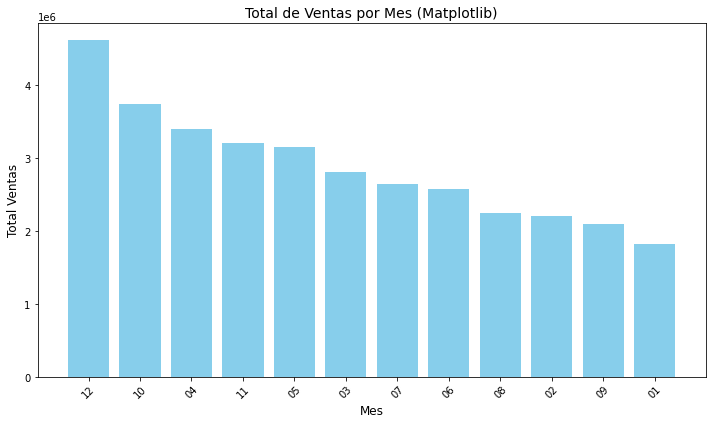

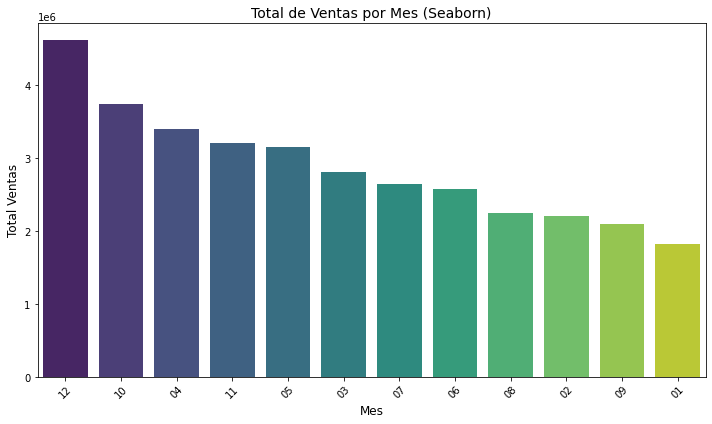

In [0]:
# Convertir a Pandas para graficar
mes_mas_ventas_pd = mes_mas_ventas.toPandas()

# Mostrar el DataFrame resultante (opcional)
print(mes_mas_ventas_pd)

# Gráfico con Matplotlib
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
plt.bar(mes_mas_ventas_pd["Month"], mes_mas_ventas_pd["Total_Ventas"], color='skyblue')
plt.title("Total de Ventas por Mes (Matplotlib)", fontsize=14)
plt.xlabel("Mes", fontsize=12)
plt.ylabel("Total Ventas", fontsize=12)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Gráfico con Seaborn
import seaborn as sns

plt.figure(figsize=(10, 6))
sns.barplot(x="Month", y="Total_Ventas", data=mes_mas_ventas_pd, palette="viridis")
plt.title("Total de Ventas por Mes (Seaborn)", fontsize=14)
plt.xlabel("Mes", fontsize=12)
plt.ylabel("Total Ventas", fontsize=12)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


  d. Obtén un gráfico con las 10 ciudades que más unidades han vendido.  
  ![](https://community.cloud.databricks.com/files/Notebook_3/3.png) 

In [0]:
combined_df.display()

Order_ID,Product,Quantity_Ordered,Price_Each,Order_Date,Purchase_Address,City,State,Month,Year
209921,USB-C Charging Cable,1,11.95,2019-06-23,"950 Walnut St, Portland, ME 04101",950 Walnut St,Portland,06,2019
209922,Macbook Pro Laptop,1,1700.0,2019-06-30,"80 4th St, San Francisco, CA 94016",80 4th St,San Francisco,06,2019
209923,ThinkPad Laptop,1,999.99,2019-06-24,"402 Jackson St, Los Angeles, CA 90001",402 Jackson St,Los Angeles,06,2019
209924,27in FHD Monitor,1,149.99,2019-06-05,"560 10th St, Seattle, WA 98101",560 10th St,Seattle,06,2019
209925,Bose SoundSport Headphones,1,99.99,2019-06-25,"545 2nd St, San Francisco, CA 94016",545 2nd St,San Francisco,06,2019
209926,Apple Airpods Headphones,1,150.0,2019-06-28,"386 Lake St, Seattle, WA 98101",386 Lake St,Seattle,06,2019
209927,Lightning Charging Cable,1,14.95,2019-06-28,"29 Lincoln St, Los Angeles, CA 90001",29 Lincoln St,Los Angeles,06,2019
209928,Apple Airpods Headphones,1,150.0,2019-06-16,"350 9th St, New York City, NY 10001",350 9th St,New York City,06,2019
209929,Wired Headphones,1,11.99,2019-06-28,"612 Meadow St, Portland, OR 97035",612 Meadow St,Portland,06,2019
209930,27in FHD Monitor,1,149.99,2019-06-02,"625 Ridge St, Los Angeles, CA 90001",625 Ridge St,Los Angeles,06,2019


              City  Total_Units
0   661 Madison St           24
1       60 10th St           20
2       689 7th St           18
3  855 Highland St           18
4      329 Hill St           18
5   992 Jackson St           18
6        96 Elm St           17
7    372 Willow St           17
8  124 Chestnut St           17
9       866 9th St           17


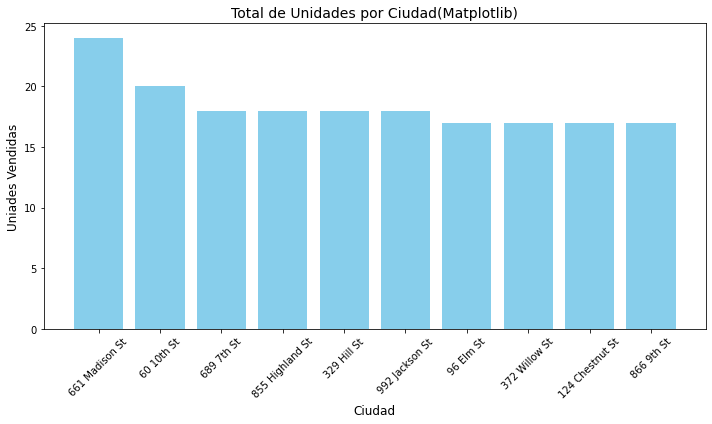

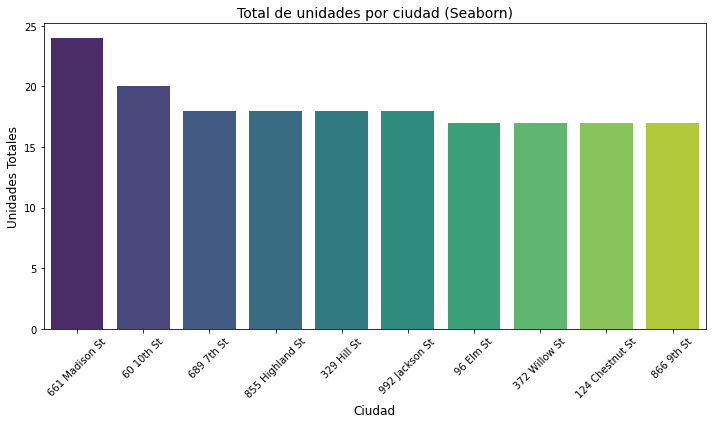

In [0]:
ciudades_units_ventas = (combined_df
                         .groupBy("City")
                         .agg(F.sum(F.col("Quantity_Ordered")).alias("Total_Units"))
                         .orderBy(F.col("Total_Units").desc()))

#ciudades_units_ventas.show(10)

pd = ciudades_units_ventas.limit(10).toPandas()
print(pd)

# Gráfico con Matplotlib
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
plt.bar(pd["City"], pd["Total_Units"], color='skyblue')
plt.title("Total de Unidades por Ciudad(Matplotlib)", fontsize=14)
plt.xlabel("Ciudad", fontsize=12)
plt.ylabel("Uniades Vendidas", fontsize=12)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Gráfico con Seaborn
import seaborn as sns

plt.figure(figsize=(10, 6))
sns.barplot(x="City", y="Total_Units", data=pd, palette="viridis")
plt.title("Total de unidades por ciudad (Seaborn)", fontsize=14)
plt.xlabel("Ciudad", fontsize=12)
plt.ylabel("Unidades Totales", fontsize=12)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


e. Cantidad de pedidos por Horas en las que se ha realizado un pedido que contenía al menos dos productos:  
![](https://community.cloud.databricks.com/files/Notebook_3/4.png) 


In [0]:
from pyspark.sql import DataFrame

# Lista de nombres de archivos
file_paths = [
    "dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/Sales_June_2019.csv",
    "dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/Sales_July_2019.csv",
    "dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/Sales_March_2019.csv",
    "dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/Sales_May_2019.csv",
    "dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/Sales_November_2019.csv",
    "dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/Sales_October_2019.csv",
    "dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/Sales_September_2019.csv",
    "dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/Sales_April_2019.csv",
    "dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/Sales_August_2019.csv",
    "dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/Sales_December_2019.csv",
    "dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/Sales_February_2019.csv",
    "dbfs:/FileStore/shared_uploads/carlosalonsomingo@gmail.com/Sales_January_2019.csv",
]

# Leer y unir todos los archivos
combined_df = None

for path in file_paths:
    df = spark.read.format("csv").option("header", "true").option("inferSchema", "true").load(path)
    combined_df = df if combined_df is None else combined_df.union(df)
combined_df = combined_df.toDF(*[col.replace(" ", "_") for col in combined_df.columns])
# Mostrar el DataFrame combinado
combined_df.show()


+--------+--------------------+----------------+----------+--------------+--------------------+
|Order_ID|             Product|Quantity_Ordered|Price_Each|    Order_Date|    Purchase_Address|
+--------+--------------------+----------------+----------+--------------+--------------------+
|  209921|USB-C Charging Cable|               1|     11.95|06/23/19 19:34|950 Walnut St, Po...|
|  209922|  Macbook Pro Laptop|               1|    1700.0|06/30/19 10:05|80 4th St, San Fr...|
|  209923|     ThinkPad Laptop|               1|    999.99|06/24/19 20:18|402 Jackson St, L...|
|  209924|    27in FHD Monitor|               1|    149.99|06/05/19 10:21|560 10th St, Seat...|
|  209925|Bose SoundSport H...|               1|     99.99|06/25/19 18:58|545 2nd St, San F...|
|  209926|Apple Airpods Hea...|               1|     150.0|06/28/19 20:04|386 Lake St, Seat...|
|  209927|Lightning Chargin...|               1|     14.95|06/28/19 00:07|29 Lincoln St, Lo...|
|  209928|Apple Airpods Hea...|         

  File <command-3398272554684946>:2
    .)
     ^
SyntaxError: invalid syntax


In [0]:
from pyspark.sql import functions as F
#!!!! Para esto usar una nueva carga del dataframe !!!!
with_hour = (combined_df
             .filter(F.col("Quantity Ordered") >= 2)
             .withColumn("Hour", F.split(F.split("Order_Date", " ")[1], ":")[0]))

res = (with_hour
           .groupBy(F.col("Hour"))
           .agg(F.count(F.col("Quantity_Ordered"))))
res.display()

Hour,count(Quantity_Ordered)
07,411
15,929
11,1187
01,215
22,833
16,986
18,1142
00,376
17,1002
09,795


In [0]:
combined_df = (combined_df.withColumn("City", F.split(combined_df.Purchase_Address, ", ")[0])
               .withColumn("State", F.split(combined_df.Purchase_Address, ", ")[1]))

display(combined_df)


Order_ID,Product,Quantity_Ordered,Price_Each,Order_Date,Purchase_Address,City,State
209921,USB-C Charging Cable,1,11.95,06/23/19 19:34,"950 Walnut St, Portland, ME 04101",950 Walnut St,Portland
209922,Macbook Pro Laptop,1,1700.0,06/30/19 10:05,"80 4th St, San Francisco, CA 94016",80 4th St,San Francisco
209923,ThinkPad Laptop,1,999.99,06/24/19 20:18,"402 Jackson St, Los Angeles, CA 90001",402 Jackson St,Los Angeles
209924,27in FHD Monitor,1,149.99,06/05/19 10:21,"560 10th St, Seattle, WA 98101",560 10th St,Seattle
209925,Bose SoundSport Headphones,1,99.99,06/25/19 18:58,"545 2nd St, San Francisco, CA 94016",545 2nd St,San Francisco
209926,Apple Airpods Headphones,1,150.0,06/28/19 20:04,"386 Lake St, Seattle, WA 98101",386 Lake St,Seattle
209927,Lightning Charging Cable,1,14.95,06/28/19 00:07,"29 Lincoln St, Los Angeles, CA 90001",29 Lincoln St,Los Angeles
209928,Apple Airpods Headphones,1,150.0,06/16/19 21:30,"350 9th St, New York City, NY 10001",350 9th St,New York City
209929,Wired Headphones,1,11.99,06/28/19 10:56,"612 Meadow St, Portland, OR 97035",612 Meadow St,Portland
209930,27in FHD Monitor,1,149.99,06/02/19 11:22,"625 Ridge St, Los Angeles, CA 90001",625 Ridge St,Los Angeles


f. Listado con los productos del estado de NY que se han comprado a la vez, obteniendo un resultado similar a: 
``` 
+------------------------------------------------------------+-----+
|Productos                                                   |count|
+------------------------------------------------------------+-----+
|[iPhone, Lightning Charging Cable]                          |126  |
|[Google Phone, USB-C Charging Cable]                        |124  |
|[Google Phone, Wired Headphones]                            |52   |
...
```

In [0]:
ny_shels = combined_df.filter(F.col("State") == "New York City")

products_together = ny_shels.groupBy("Order_ID")

+--------+--------------------+----------------+----------+--------------+--------------------+--------------+-------------+
|Order_ID|             Product|Quantity_Ordered|Price_Each|    Order_Date|    Purchase_Address|          City|        State|
+--------+--------------------+----------------+----------+--------------+--------------------+--------------+-------------+
|  209928|Apple Airpods Hea...|               1|     150.0|06/16/19 21:30|350 9th St, New Y...|    350 9th St|New York City|
|  209931|Apple Airpods Hea...|               1|     150.0|06/24/19 13:55|761 14th St, New ...|   761 14th St|New York City|
|  209951|27in 4K Gaming Mo...|               1|    389.99|06/30/19 13:04|998 Johnson St, N...|998 Johnson St|New York City|
|  209962|USB-C Charging Cable|               1|     11.95|06/23/19 10:58|441 Cherry St, Ne...| 441 Cherry St|New York City|
|  209966|Lightning Chargin...|               1|     14.95|06/20/19 09:46|743 Adams St, New...|  743 Adams St|New York City|


In [0]:
combined_df.show()


+--------+--------------------+----------------+----------+--------------+--------------------+---------------+-------------+
|Order_ID|             Product|Quantity_Ordered|Price_Each|    Order_Date|    Purchase_Address|           City|        State|
+--------+--------------------+----------------+----------+--------------+--------------------+---------------+-------------+
|  209921|USB-C Charging Cable|               1|     11.95|06/23/19 19:34|950 Walnut St, Po...|  950 Walnut St|     Portland|
|  209922|  Macbook Pro Laptop|               1|    1700.0|06/30/19 10:05|80 4th St, San Fr...|      80 4th St|San Francisco|
|  209923|     ThinkPad Laptop|               1|    999.99|06/24/19 20:18|402 Jackson St, L...| 402 Jackson St|  Los Angeles|
|  209924|    27in FHD Monitor|               1|    149.99|06/05/19 10:21|560 10th St, Seat...|    560 10th St|      Seattle|
|  209925|Bose SoundSport H...|               1|     99.99|06/25/19 18:58|545 2nd St, San F...|     545 2nd St|San Fra

In [0]:

prod_NY = (combined_df
           .filter(F.col("State") == "New York City")
           .withColumnRenamed("Order_Date", "Order_Date_NY")
           .withColumnRenamed("Product", "Product_NY")
           .withColumnRenamed("State", "State_NY")
           )

#Despues de filtrar agrupo por la fecha , agrego la recoleccion de los productos en una lista y otra columna con el tamaño de esa lista, luego me quedo con los que son mayor a 2 y selecciono las columnas necesarias 
prod_list = (
  prod_NY.groupBy("Order_Date_NY")
  .agg(F.collect_list("Product_NY").alias("Productos"), F.size(F.col("Productos")).alias("count"))
  .filter(F.col("count")> 1)
  .select("Productos", "count")
  
  )

prod_list.display()


Productos,count
"List(iPhone, Wired Headphones)",2
"List(Google Phone, Wired Headphones)",2
"List(iPhone, Lightning Charging Cable)",2
"List(Bose SoundSport Headphones, Lightning Charging Cable)",2
"List(Lightning Charging Cable, 20in Monitor)",2
"List(Apple Airpods Headphones, Apple Airpods Headphones)",2
"List(AA Batteries (4-pack), 27in 4K Gaming Monitor)",2
"List(iPhone, Lightning Charging Cable)",2
"List(AAA Batteries (4-pack), 27in FHD Monitor)",2
"List(Vareebadd Phone, USB-C Charging Cable)",2


In [0]:
##Esto seria para obtener las parejas de productos de NY venndidos en el mismo momento, pero creo que no es lo que pide la pregunta

from pyspark.sql import functions as F

# Filtrar los datos del estado de Nueva York
prod_NY = (combined_df
           .filter(F.col("State") == "New York City")
           .withColumnRenamed("Order_Date", "Order_Date_NY")
           .withColumnRenamed("Product", "Product_NY")
           .withColumnRenamed("State", "State_NY")
           )

# Asignar alias para evitar ambigüedades
prod_NY_alias = prod_NY.alias("prod_NY")
combined_df_alias = combined_df.alias("combined")

# Seleccionar columnas relevantes de ambos DataFrames
prod_NY_selected = prod_NY_alias.select(
    F.col("Order_Date_NY"),
    F.col("Product_NY"),
    F.col("State_NY"),
    F.col("Order_ID").alias("Order_ID_NY")  # Si es necesario
)

combined_df_selected = combined_df_alias.select(
    F.col("Order_Date"),
    F.col("Product"),
    F.col("State"),
    F.col("Order_ID")  # Si es necesario
)

# Realizar el join
res = prod_NY_selected.join(
    combined_df_selected,
    (prod_NY_selected["Order_Date_NY"] == combined_df_selected["Order_Date"]) &
    (prod_NY_selected["Product_NY"] < combined_df_selected["Product"]) &
    (prod_NY_selected["State_NY"] == combined_df_selected["State"])
)

# Mostrar el resultado
res.display()


Order_Date_NY,Product_NY,State_NY,Order_ID_NY,Order_Date,Product,State,Order_ID
06/22/19 14:27,USB-C Charging Cable,New York City,210837,06/22/19 14:27,Vareebadd Phone,New York City,210837
06/25/19 12:48,Lightning Charging Cable,New York City,214748,06/25/19 12:48,iPhone,New York City,214748
06/30/19 21:34,Flatscreen TV,New York City,215758,06/30/19 21:34,Lightning Charging Cable,New York City,219228
06/09/19 12:32,Lightning Charging Cable,New York City,218732,06/09/19 12:32,Wired Headphones,New York City,222315
06/29/19 19:51,AAA Batteries (4-pack),New York City,215581,06/29/19 19:51,Flatscreen TV,New York City,211953
06/29/19 18:38,USB-C Charging Cable,New York City,211939,06/29/19 18:38,Vareebadd Phone,New York City,211939
06/02/19 09:50,AAA Batteries (4-pack),New York City,221786,06/02/19 09:50,USB-C Charging Cable,New York City,216920
06/17/19 20:59,Lightning Charging Cable,New York City,210883,06/17/19 20:59,iPhone,New York City,210883
06/14/19 20:57,AAA Batteries (4-pack),New York City,210735,06/14/19 20:57,Apple Airpods Headphones,New York City,217395
06/25/19 10:11,Bose SoundSport Headphones,New York City,222836,06/25/19 10:11,iPhone,New York City,220718


# Guias
### 1. Guía rápida de comandos de PySpark

In [0]:
# Seleccionar columnas
df.select("column_name").show()

# Filtrar filas
df.filter(df["column_name"] > value).show()

# Ordenar filas
df.orderBy("column_name", ascending=False).show()

# Agregar una nueva columna calculada
df.withColumn("new_column", F.col("column1") * F.col("column2")).show()

# Eliminar duplicados
df.dropDuplicates(["column_name"]).show()

# Contar filas
df.count()

# Agrupar y agregar
df.groupBy("group_column").agg(F.sum("column_to_sum")).show()


---------------------------------------------------------------------------
AnalysisException                         Traceback (most recent call last)
File <command-781094084072198>:2
      1 # Seleccionar columnas
----> 2 df.select("column_name").show()
      4 # Filtrar filas
      5 df.filter(df["column_name"] > value).show()

File /databricks/spark/python/pyspark/instrumentation_utils.py:48, in _wrap_function.<locals>.wrapper(*args, **kwargs)
     46 start = time.perf_counter()
     47 try:
---> 48     res = func(*args, **kwargs)
     49     logger.log_success(
     50         module_name, class_name, function_name, time.perf_counter() - start, signature
     51     )
     52     return res

File /databricks/spark/python/pyspark/sql/dataframe.py:3023, in DataFrame.select(self, *cols)
   2978 def select(self, *cols: "ColumnOrName") -> "DataFrame":  # type: ignore[misc]
   2979     """Projects a set of expressions and returns a new :class:`DataFrame`.
   2980 
   2981     .. version

### 2. Ejemplos de transformaciones y acciones

In [0]:
# Agrupar por columna y calcular suma
from pyspark.sql import functions as F
grouped_df = df.groupBy("Month").agg(F.sum("Sales").alias("Total_Sales"))
grouped_df.show()

# Filtrar filas donde las ventas superen un umbral
filtered_df = df.filter(F.col("Sales") > 1000)
print(f"Número de filas filtradas: {filtered_df.count()}")

# Calcular porcentaje del total
total_sales = df.agg(F.sum("Sales")).collect()[0][0]
df = df.withColumn("Percentage", F.col("Sales") / total_sales * 100)
df.show()

# Calcular porcentaje del total
total_sales = df.agg(F.sum("Sales")).collect()[0][0]
df = df.withColumn("Percentage", F.col("Sales") / total_sales * 100)
df.show()


---------------------------------------------------------------------------
AnalysisException                         Traceback (most recent call last)
File <command-781094084072199>:3
      1 # Agrupar por columna y calcular suma
      2 from pyspark.sql import functions as F
----> 3 grouped_df = df.groupBy("Month").agg(F.sum("Sales").alias("Total_Sales"))
      4 grouped_df.show()
      6 # Filtrar filas donde las ventas superen un umbral

File /databricks/spark/python/pyspark/instrumentation_utils.py:48, in _wrap_function.<locals>.wrapper(*args, **kwargs)
     46 start = time.perf_counter()
     47 try:
---> 48     res = func(*args, **kwargs)
     49     logger.log_success(
     50         module_name, class_name, function_name, time.perf_counter() - start, signature
     51     )
     52     return res

File /databricks/spark/python/pyspark/sql/group.py:177, in GroupedData.agg(self, *exprs)
    175     assert all(isinstance(c, Column) for c in exprs), "all exprs should be Column"
 

### 3. Visualización con Matplotlib y Seaborn

In [0]:
# Convertir a Pandas
pandas_df = df.toPandas()

# Graficar con Matplotlib
import matplotlib.pyplot as plt

plt.bar(pandas_df["Month"], pandas_df["Total_Sales"])
plt.title("Ventas Totales por Mes")
plt.xlabel("Mes")
plt.ylabel("Ventas Totales")
plt.show()


In [0]:
# Graficar con Seaborn
import seaborn as sns

sns.barplot(data=pandas_df, x="Month", y="Total_Sales")
plt.title("Ventas Totales por Mes")
plt.show()


### 4. Gestión de datos nulos

In [0]:
#Eliminar filas con nulos
df = df.dropna()

#Reemplazar valores nulos
df = df.fillna({"column_name": 0})


### 5. Particionado y almacenamiento
Si el examen incluye guardar datos procesados, muestra ejemplos con formato Parquet:

In [0]:
#Guardar datos en formato Parquet
df.write.format("parquet").mode("overwrite").save("path_to_output")


In [0]:
#Leer datos particionados
df = spark.read.format("parquet").load("path_to_output/Year=2021")


### 6. Comandos Spark SQL

In [0]:
#Registrar una tabla temporal:
df.createOrReplaceTempView("sales_data")

# Consultar datos con SQL:
spark.sql("SELECT Month, SUM(Sales) as Total_Sales FROM sales_data GROUP BY Month").show()


### 7. Resolución de errores comunes
Incluye ejemplos para manejar errores frecuentes:

- Error: Column object is not callable:
Usar F.col("column_name") en lugar de "column_name".
- Error al sumar cadenas:
Asegúrate de convertir las columnas a los tipos adecuados:

In [0]:
df = df.withColumn("column_name", F.col("column_name").cast("int"))


### 8. Validaciones rápidas para el examen
Proporciona funciones pequeñas para validaciones, como verificar el tipo de datos o el esquema:

In [0]:
#Validar esquema:
df.printSchema()
#Verificar valores únicos:
df.select("column_name").distinct().show()


#Funciones de apoyo

## Funciones para graficar


### Funcion para graficar con matplotlib

In [0]:
import matplotlib.pyplot as plt

def plot_bar_matplotlib(data, x_col, y_col, title="", x_label="", y_label="", figsize=(10, 6), color="skyblue"):
    """
    Función para graficar un gráfico de barras con Matplotlib.

    Parámetros:
        data (pd.DataFrame): DataFrame de Pandas con los datos.
        x_col (str): Nombre de la columna para el eje X.
        y_col (str): Nombre de la columna para el eje Y.
        title (str): Título del gráfico.
        x_label (str): Etiqueta del eje X.
        y_label (str): Etiqueta del eje Y.
        figsize (tuple): Tamaño de la figura.
        color (str): Color de las barras.
    """
    plt.figure(figsize=figsize)
    plt.bar(data[x_col], data[y_col], color=color)
    plt.title(title, fontsize=14)
    plt.xlabel(x_label, fontsize=12)
    plt.ylabel(y_label, fontsize=12)
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()


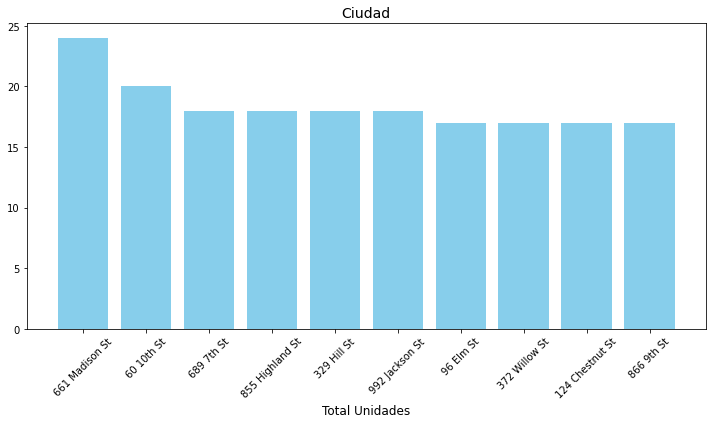

In [0]:
plot_bar_matplotlib(pd,"City", "Total_Units", "Ciudad", "Total Unidades")

### Funcion para graficar con Seaborn

In [0]:
import seaborn as sns

def plot_bar_seaborn(data, x_col, y_col, title="", x_label="", y_label="", figsize=(10, 6), palette="viridis"):
    """
    Función para graficar un gráfico de barras con Seaborn.

    Parámetros:
        data (pd.DataFrame): DataFrame de Pandas con los datos.
        x_col (str): Nombre de la columna para el eje X.
        y_col (str): Nombre de la columna para el eje Y.
        title (str): Título del gráfico.
        x_label (str): Etiqueta del eje X.
        y_label (str): Etiqueta del eje Y.
        figsize (tuple): Tamaño de la figura.
        palette (str): Paleta de colores de Seaborn.
    """
    plt.figure(figsize=figsize)
    sns.barplot(x=x_col, y=y_col, data=data, palette=palette)
    plt.title(title, fontsize=14)
    plt.xlabel(x_label, fontsize=12)
    plt.ylabel(y_label, fontsize=12)
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()


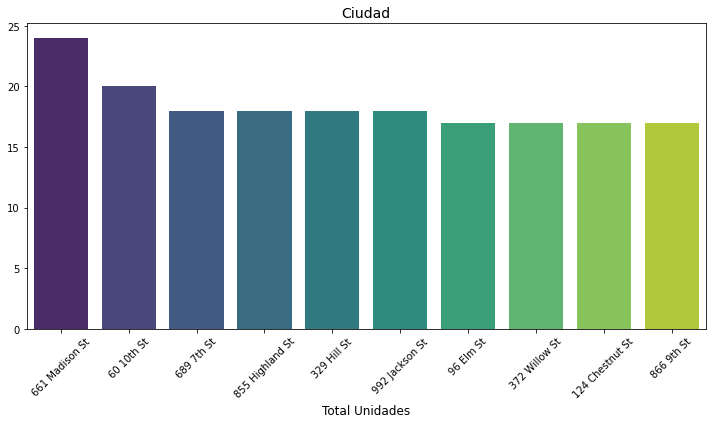

In [0]:
plot_bar_seaborn(pd,"City", "Total_Units", "Ciudad", "Total Unidades")

## Función 1: Contar valores únicos

In [0]:
def count_distinct(df, column_name):
    '''
    Cuenta valores únicos en una columna específica.
    
    Args:
        df: DataFrame de PySpark.
        column_name (str): Nombre de la columna para contar valores únicos.

    Returns:
        int: Número de valores únicos.
    '''
    return df.select(column_name).distinct().count()

# Ejemplo de uso:
# unique_count = count_distinct(df, "ColumnName")


## Función 2: Calcular resumen estadístico

In [0]:
def describe_columns(df, columns):
    '''
    Calcula estadísticas descriptivas (min, max, mean, etc.) de columnas específicas.
    
    Args:
        df: DataFrame de PySpark.
        columns (list): Lista de columnas a describir.

    Returns:
        DataFrame: Resumen estadístico.
    '''
    return df.select(columns).describe()

# Ejemplo de uso:
# stats = describe_columns(df, ["Column1", "Column2"])


## Función 3: Agrupar por columna y sumar

In [0]:
def group_and_sum(df, group_column, sum_column):
    '''
    Agrupa por una columna y calcula la suma de otra.
    
    Args:
        df: DataFrame de PySpark.
        group_column (str): Nombre de la columna para agrupar.
        sum_column (str): Nombre de la columna para sumar.

    Returns:
        DataFrame: Resultado de la agrupación y suma.
    '''
    from pyspark.sql import functions as F
    return df.groupBy(group_column).agg(F.sum(sum_column).alias(f"sum_{sum_column}"))

# Ejemplo de uso:
# grouped_data = group_and_sum(df, "GroupColumn", "SumColumn")


## Función 4: Filtrar datos por condición

In [0]:
def filter_data(df, condition):
    '''
    Filtra un DataFrame basado en una condición.
    
    Args:
        df: DataFrame de PySpark.
        condition (str): Condición de filtrado (usando SQL expressions).

    Returns:
        DataFrame: DataFrame filtrado.
    '''
    return df.filter(condition)

# Ejemplo de uso:
# filtered_df = filter_data(df, "ColumnName > 100")


## Función 5: Crear columna calculada

In [0]:
def add_calculated_column(df, new_column_name, calculation):
    '''
    Añade una nueva columna calculada a un DataFrame.
    
    Args:
        df: DataFrame de PySpark.
        new_column_name (str): Nombre de la nueva columna.
        calculation: Operación de PySpark para la columna calculada.

    Returns:
        DataFrame: DataFrame con la nueva columna.
    '''
    return df.withColumn(new_column_name, calculation)

# Ejemplo de uso:
# df = add_calculated_column(df, "Revenue", F.col("Quantity") * F.col("Price"))
